<a href="https://colab.research.google.com/github/ParsaMohammadpour/Graph-1st-Assignment/blob/main/graph_failures.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
%pip install networkx

In [2]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import random
from collections import Counter
import os

# Initialization

### Parameters

In [3]:
MIN_NODE_NOMBER = 100
MAX_NODE_NUMBER = 100
GRAPH_NUMBER = 2
FAILURE = [i/100 for i in range(1, 31)]
SIMULATION_NUMBER = 2

### Making Folders

If we want to save plots, we need to uncomment

```
for path in {$}.values():
   os.mkdir(path) if not os.path.exists(path) else None
```
from following code.






In [4]:
SMALL_WORLD_PATH = {'root': 'Small-world'
                    , 'degree': 'Small-World/Degree-Distributions'
                    , 'graph': 'Small-World/Graphs'
                    , 'log': 'Small-World/Double-Log'
                    , 'sim-node': 'Small-World/Simulation/NodeFailure'
                    , 'sim-edge': 'Small-World/Simulation/EdgeFailure'
                    , 'sim-node-compare': 'Small-World/Simulation/NodeFailureCompare'
                    , 'sim-edge-compare': 'Small-World/Simulation/EdgeFailureCompare'
                    , 'ci-node-isolation': 'Small-World/Simulation/CI-Isolation'
                    , 'ci-edge-isolation': 'Small-World/Simulation/CI-Isolation'
                    , 'ci-node-disconnection': 'Small-World/Simulation/CI-Disconnection'
                    , 'ci-edge-disconnection': 'Small-World/Simulation/CI-Disconnection'}

# for path in SMALL_WORLD_PATH.values():
#    os.mkdir(path) if not os.path.exists(path) else None

SCALE_FREE_PATH = {'root': 'Scale-Free'
                    , 'degree': 'Scale-Free/Degree-Distributions'
                    , 'graph': 'Scale-Free/Graphs'
                    , 'log': 'Scale-Free/Double-Log'
                    , 'sim-node': 'Scale-Free/Simulation/NodeFailure'
                    , 'sim-edge': 'Scale-Free/Simulation/EdgeFailure'
                    , 'sim-node-compare': 'Scale-Free/Simulation/NodeFailureCompare'
                    , 'sim-edge-compare': 'Scale-Free/Simulation/EdgeFailureCompare'
                    , 'ci-node-isolation': 'Scale-Free/Simulation/CI-Isolation'
                    , 'ci-edge-isolation': 'Scale-Free/Simulation/CI-Isolation'
                    , 'ci-node-disconnection': 'Scale-Free/Simulation/CI-Disconnection'
                    , 'ci-edge-disconnection': 'Scale-Free/Simulation/CI-Disconnection'}

# for path in SCALE_FREE_PATH.values():
#    os.mkdir(path) if not os.path.exists(path) else None

RANDOM_PATH = {'root': 'Random'
                    , 'degree': 'Random/Degree-Distributions'
                    , 'graph': 'Random/Graphs'
                    , 'log': 'Random/Double-Log'
                    , 'sim-node': 'Random/Simulation/NodeFailure'
                    , 'sim-edge': 'Random/Simulation/EdgeFailure'
                    , 'sim-node-compare': 'Random/Simulation/NodeFailureCompare'
                    , 'sim-edge-compare': 'Random/Simulation/EdgeFailureCompare'
                    , 'ci-node-isolation': 'Random/Simulation/CI-Isolation'
                    , 'ci-edge-isolation': 'Random/Simulation/CI-Isolation'
                    , 'ci-node-disconnection': 'Random/Simulation/CI-Disconnection'
                    , 'ci-edge-disconnection': 'Random/Simulation/CI-Disconnection'}


# for path in RANDOM_PATH.values():
#    os.mkdir(path) if not os.path.exists(path) else None

### Function For Saving Graphs & Plots

In [5]:
def save_graph_base(graph_infos, PATH):
  return
  counter = 1
  for graph_info in graph_infos:
      graph_path = PATH['graph'] + '/' + str(counter) + '.png'
      show_graph(graph_info['graph'], path=graph_path)

      degree_path = PATH['degree'] + '/' + str(counter) + '.png'
      degree_distribution(graph_info['graph'], path=degree_path)

      log_path = PATH['log'] + '/' + str(counter) + '.png'
      double_log(graph_info['graph'], path=log_path)
      counter = counter + 1

# Some Plots

If we want to save plots, we need to uncomment

```
if path != None:
        plt.savefig(path+'.png')
```
from following functions.






In [6]:
def coefficient_interval_plot(data, path=None, alpha=0.95):
    x = np.array([i for i in range(len(data))])
    y = np.array(data)
    # plotting
    plt.plot(y, x,'o', color='blue', label='data')

    # confidence intervals
    p = ((1.0-alpha)/2.0) * 100
    # percentile function returns the numbers which that percent of
    # the array elements areless equal then that number
    lower =  np.percentile(y, p)
    p = (alpha+((1.0-alpha)/2.0)) * 100
    upper =  np.percentile(y, p)
#     print(f"\n{alpha*100} confidence interval {lower} and {upper}")

    # c.i upper & lower
    upper_y = np.array([0, len(data)])
    upper_x = np.array([upper, upper])
    plt.plot(upper_x, upper_y, color='red', linestyle='-.', label='upper c.i')

    lower_y = np.array([0, len(data)])
    lower_x = np.array([lower, lower])
    plt.plot(lower_x, lower_y, color='orange', linestyle='-.', label='lower c.i')

    ci_x = np.array([lower, upper])
    ci_y = np.array([0, 0])
    plt.plot(ci_x, ci_y, '-', color='green', label='c.i')
    plt.legend(loc='best')
    # if path != None:
    #     plt.savefig(path+'.png')
    plt.show()

In [7]:
def coefficient_interval_plot2(data, path=None, alpha=0.95):
    x = np.array(list(range(len(data))))
    y = np.array(data)
    # Plotting data
    plt.plot(x, y, '-o', color='red', label='data')

    # Define the confidence interval
    ci = (1.0-alpha) * np.std(y) / np.mean(y)

    # Plot the confidence interval
    plt.fill_between(x, (y-ci), (y+ci), color='blue', alpha=0.1)
    plt.plot(x, (y-2*ci), '--', color='blue', label='-*ci')
    plt.plot(x, (y+2*ci), '--', color='blue', label='+*ci')
    plt.fill_between(x, (y-2*ci), (y+2*ci), color='green', alpha=.1)
    plt.plot(x, (y-2*ci), '--', color='green', label='-2*ci')
    plt.plot(x, (y+2*ci), '--', color='green', label='+2*ci')
    plt.legend(loc='best')
    # if path != None:
    #     plt.savefig(path+'.png')
    plt.show()

In [8]:
def coefficient_interval_plot3(data, path=None, alpha=0.95):
    x = np.array(list(range(len(data))))
    y = np.array(data)
    # Plotting data
    plt.plot(x, y, '-o', color='red', label='data')

    # confidence intervals
    ci = (1.0-alpha) * np.std(y) / np.mean(y)
    mean = np.mean(y)
    avg = [mean for i in range(len(data))]

    # Plot the confidence interval
    plt.fill_between(x, (avg-ci), (avg+ci), color='blue', alpha=0.1)
    plt.plot(x, (avg-ci), '--', color='blue', label='-*ci')
    plt.plot(x, (avg+ci), '--', color='blue', label='+*ci')
    plt.fill_between(x, (avg-2*ci), (avg+2*ci), color='green', alpha=.1)
    plt.plot(x, (avg-2*ci), '--', color='green', label='-2*ci')
    plt.plot(x, (avg+2*ci), '--', color='green', label='+2*ci')
    plt.legend(loc='best')
    # if path != None:
    #     plt.savefig(path+'.png')
    plt.show()

In [9]:
def simulation_diff_plot(isolation, disconnection, failure, path=None):
    plt.plot(list(range(len(disconnection))),disconnection, 'o-', color = 'red', label='disconnection')
    plt.plot(list(range(len(isolation))), isolation, 'o-', color = 'blue', label='isolation')
    plt.title('isolation an probability results for failure ' + str(failure))
    plt.xlabel('simulation number')
    plt.ylabel('probability')
    plt.legend(loc='best') # setting best location for labels
    # if path != None:
    #     plt.savefig(path+'.png')
    plt.show()

In [10]:
def draw_isolation_disconnection_plot(isolation, disconnection, path=None):
    plt.plot(FAILURE, disconnection, 'o-', color='red', label='disconnection')
    plt.plot(FAILURE, isolation, 'o-', color='blue', label='isolation')
    plt.xlabel("node failure probability")
    plt.ylabel("probability")
    plt.title('isolation & disconnection Probability')
    plt.legend(loc='best') # setting best location for labels
    # if path != None:
    #     plt.savefig(path+'.png')
    plt.show()

In [11]:
def show_graph(graph, path=None):
    pos = nx.circular_layout(graph)
    plt.figure(figsize = (12, 12))
    nx.draw_networkx(graph, pos)
    # if path != None:
    #     plt.savefig(path+'.png')
    plt.show()

In [12]:
def degree_distribution(graph, path=None):
    degrees = [graph.degree(n) for n in graph.nodes()]
    degree_freq_dic = Counter(degrees)
    x_axis = degree_freq_dic.keys()
    y_axis = degree_freq_dic.values()
    plt.title('Degree Distribution')
    plt.xlabel("Degree")
    plt.ylabel("Frequesncy")
    plt.plot(x_axis, y_axis, 'o')
    # if path != None:
    #     plt.savefig(path+'.png')
    plt.show()

In [13]:
def double_log(graph, path=None):
    degrees = [graph.degree(n) for n in graph.nodes()]
    degree_freq_dic = Counter(degrees)
    unique_degrees = list(degree_freq_dic.keys())
    frequency = list(degree_freq_dic.values())
    x_axis = np.log(unique_degrees)
    y_axis = np.log(frequency)
    plt.xlabel("Degree")
    plt.ylabel("Frequesncy")
    plt.title('Double Log')
    plt.plot(x_axis, y_axis, 'o')
    # if path != None:
    #     plt.savefig(path+'.png')
    plt.show()

# Function For Applying Failure

In [14]:
# removing nodes of graphs
# returns graph after node failure
def graph_node_failure(graph, failure):
    nodes = [i for i in graph.nodes]
    for node in nodes:
        graph.remove_node(node) if random.uniform(0.0, 1) <= failure else None

    return graph

In [15]:
# removing edges of graph
# returns graph after edge failure
def graph_edge_failure(graph, failure):
    edges = [i for i in graph.edges]
    for edge in edges:
        graph.remove_edge(edge[0], edge[1]) if random.uniform(0.0, 1) <= failure else None

    return graph

In [16]:
# iterate over all graphs & apply the failure
# then iterate over new graphs (graphs after failure applied)
# and returns isolation & disconnection probabillity
def isolation_disconnection_for_failure(graphs, failure, is_node_failure=True):
    new_graphs = []
    if is_node_failure:
        new_graphs = [graph_node_failure(graph.copy(), failure) for graph in graphs]
    else:
        new_graphs = [graph_edge_failure(graph.copy(), failure) for graph in graphs]

    isolation = [len(list(nx.isolates(graph))) > 0 for graph in new_graphs]
    disconection = [not nx.is_connected(graph) for graph in new_graphs]

    isolation_probability = sum(isolation) / len(graphs)
    disconnection_probability = sum(disconection) / len(graphs)

    return isolation_probability, disconnection_probability

In [17]:
def apply_failure(graphs, is_node_failure=True, path=None):
    isolates = []
    disconnect = []
    for failure in FAILURE:
        isolation_probability, disconnection_probability = isolation_disconnection_for_failure(graphs, failure, is_node_failure)

#         print('probability of isolated graphs for failure ' + str(failure) + ' is: ', isolation_probability)
        isolates.append(isolation_probability)
#         print('probability of isolated graphs for disconected ' + str(failure) + ' is: ', disconnection_probability)
        disconnect.append(disconnection_probability)
#         print()

    draw_isolation_disconnection_plot(isolates, disconnect, path)
    return isolates, disconnect

# Small World

### Making Graph

In [18]:
# n = number of nodes
# k = number of nodes join by k nearest neighbors
# p = probablity of rewiring each edge

small_worlds = []
for i in range(GRAPH_NUMBER):
    nodes_number = random.randint(MIN_NODE_NOMBER, MAX_NODE_NUMBER)
    k_neighbors = random.randrange(2, 10, 2)
    rewiring_probability = random.uniform(0.3, 0.6)
    graph = nx.watts_strogatz_graph(n=nodes_number, k=k_neighbors, p=rewiring_probability)
    graph_dic = {
        'nodes_number': nodes_number,
        'k_neighbors': k_neighbors,
        'rewiring_probability': rewiring_probability,
        'graph': graph
    }
    small_worlds.append(graph_dic)

### Saving Plots

In [19]:
# save_graph_base(small_worlds, SMALL_WORLD_PATH)

### Applying Node Failure

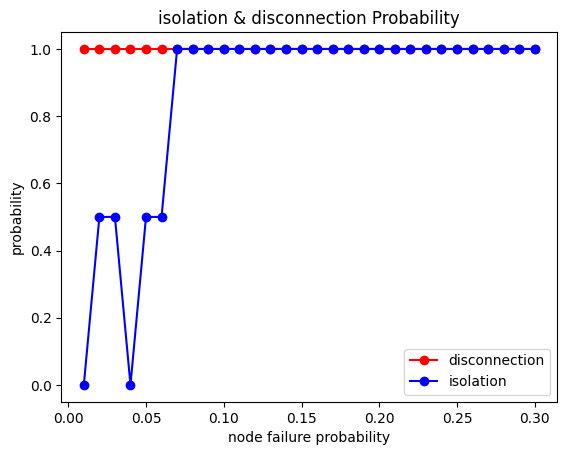

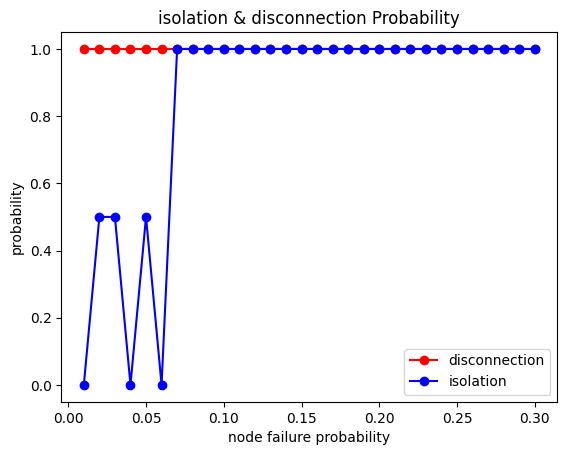

In [20]:
graphs = [info['graph'] for info in small_worlds]

isolations = []
disconnections = []
for i in range(SIMULATION_NUMBER):
    path = SMALL_WORLD_PATH['sim-node'] + '/SimulationNumber' + str(i)
    isolation, disconnection = apply_failure(graphs, is_node_failure=True, path=path)
    isolations.append(isolation)
    disconnections.append(disconnection)

###### Comparing Different Simulations for Node Failure

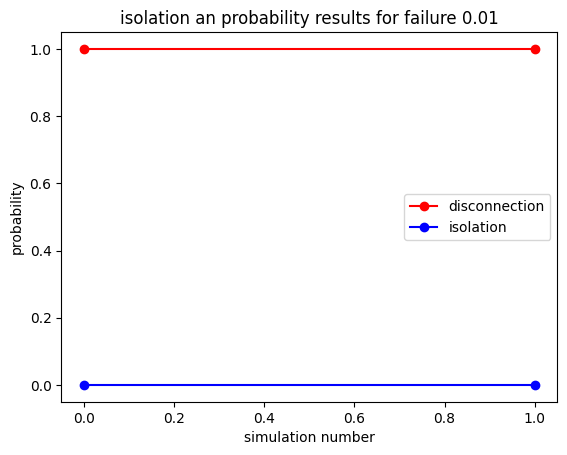

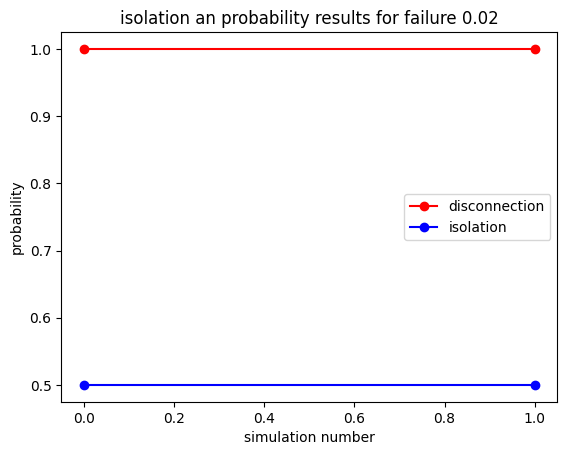

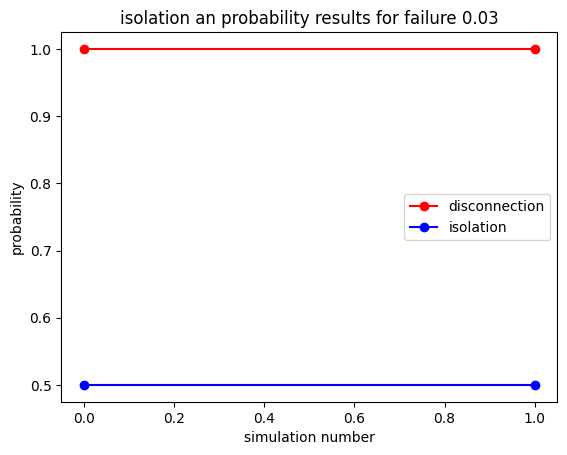

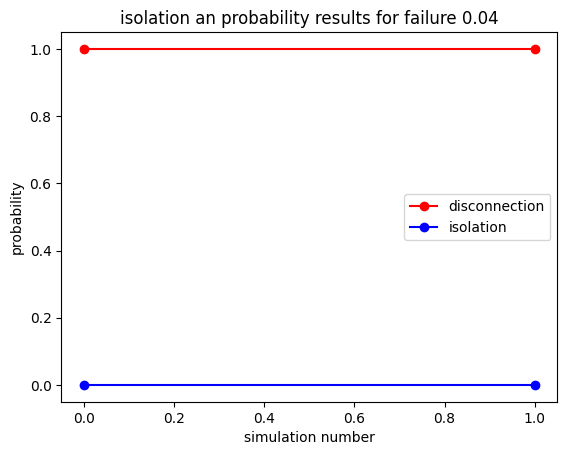

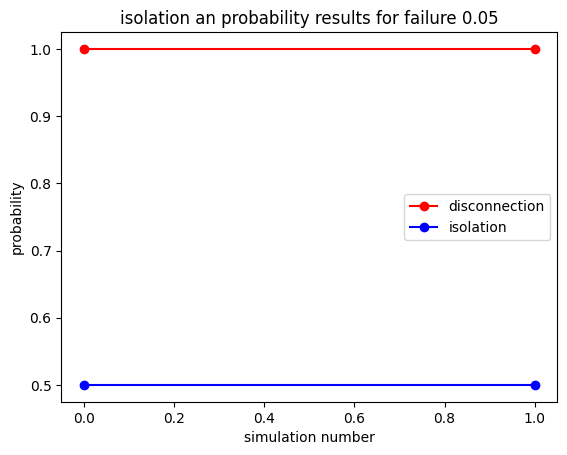

...

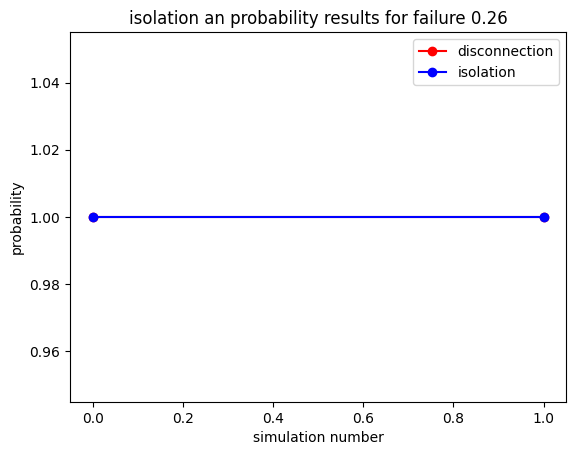

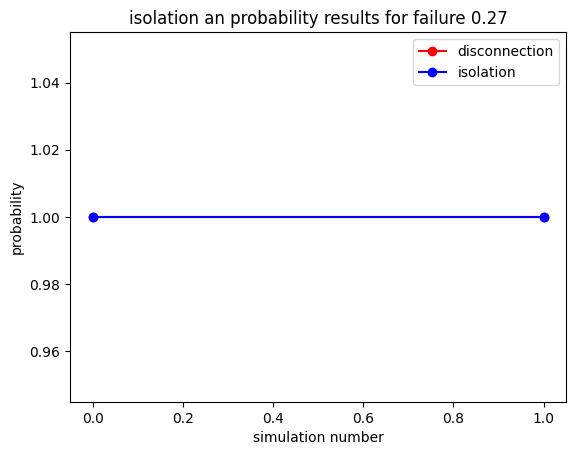

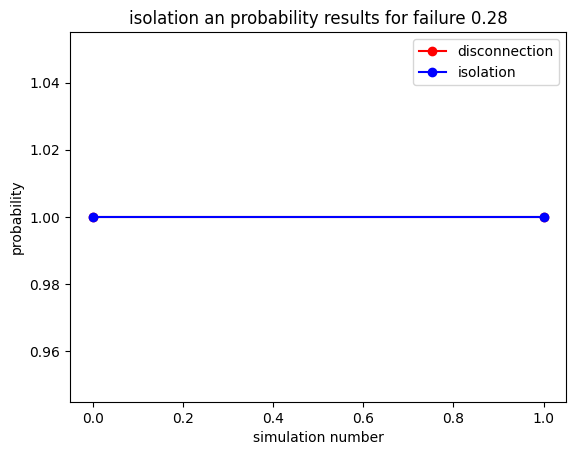

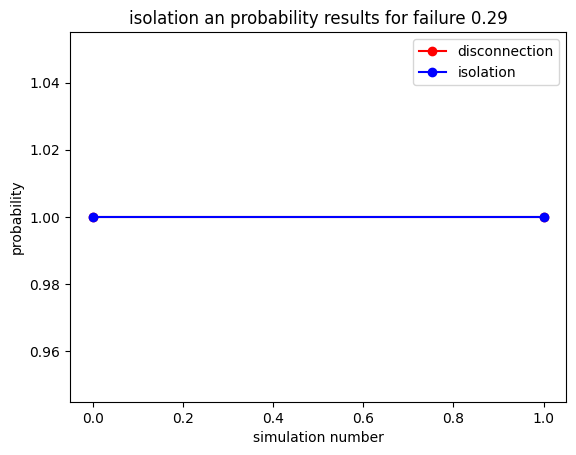

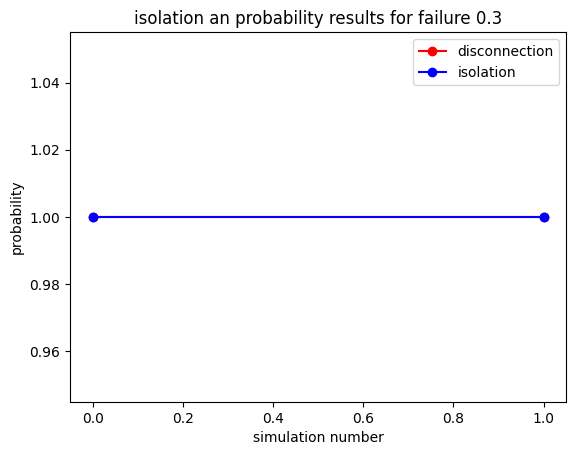

In [21]:
for sim_no in range(len(FAILURE)):
    failure_isolations = [i[sim_no] for i in isolations]
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = SMALL_WORLD_PATH['sim-node-compare'] + '/Failure' + str(int(100 * FAILURE[sim_no]))
    simulation_diff_plot(failure_isolations, failure_disconnections, FAILURE[sim_no], path=path)

###### Node C.I

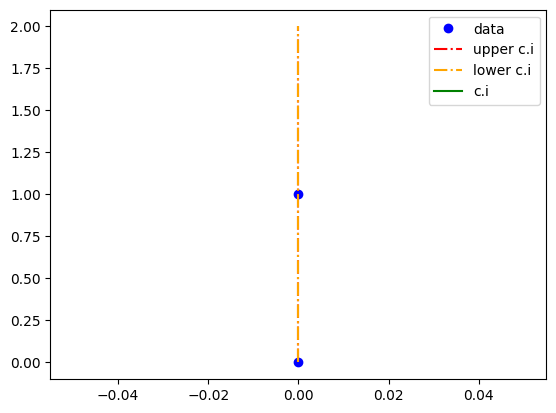

<ipython-input-7-0ffeaae0d318>:8: RuntimeWarning: invalid value encountered in scalar divide
  ci = (1.0-alpha) * np.std(y) / np.mean(y)


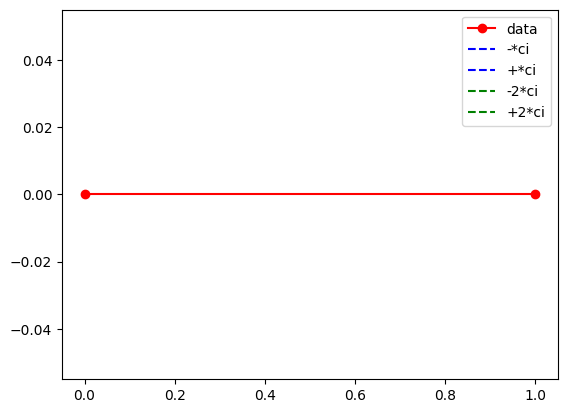

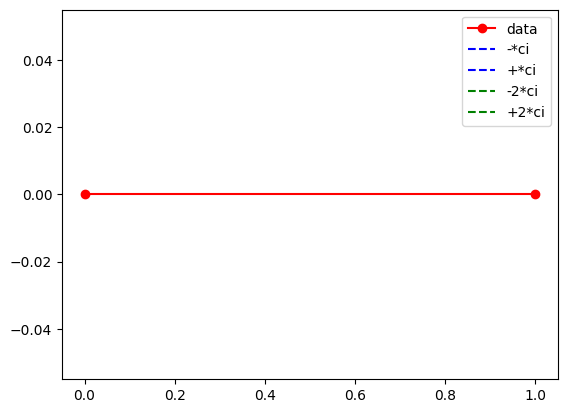

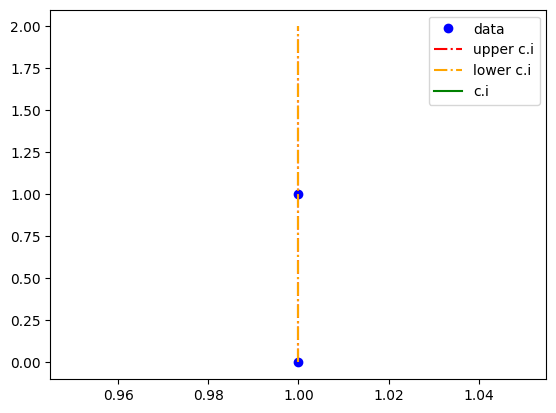

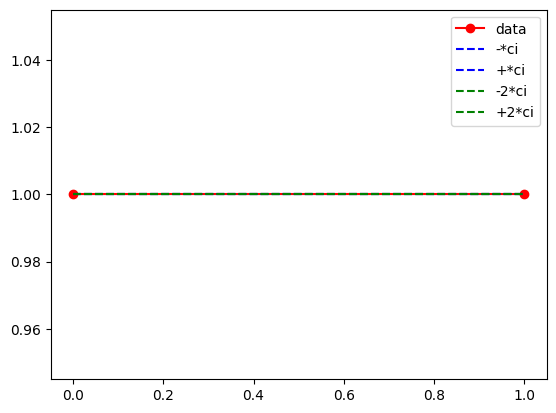

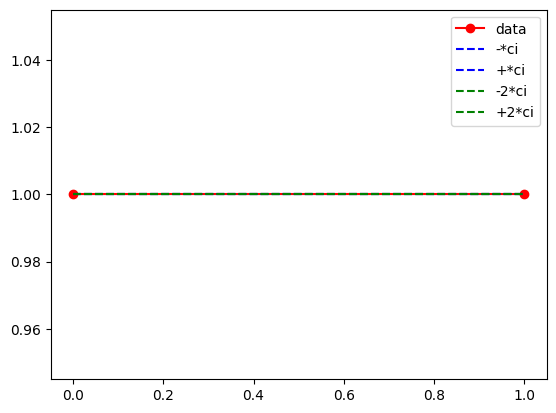

...

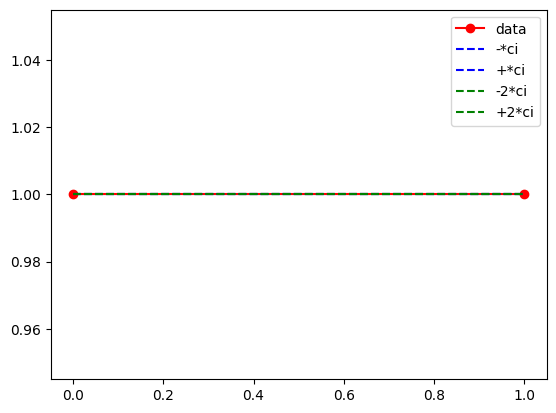

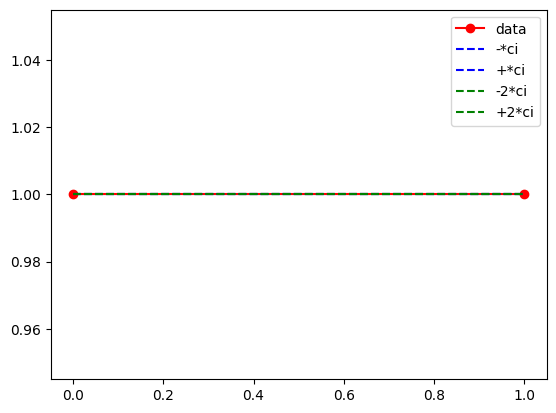

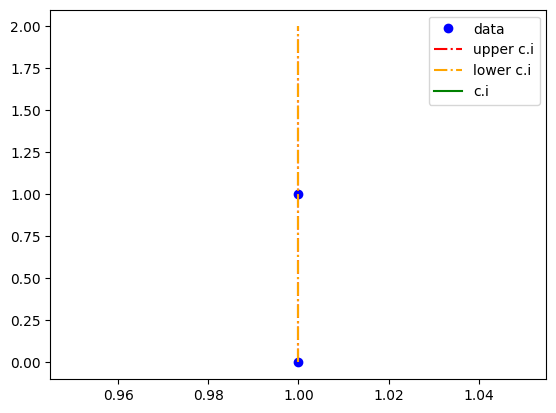

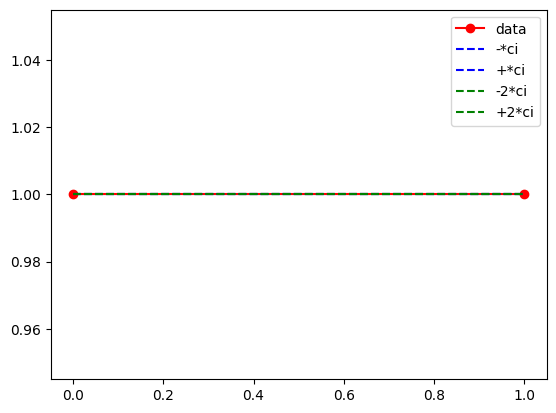

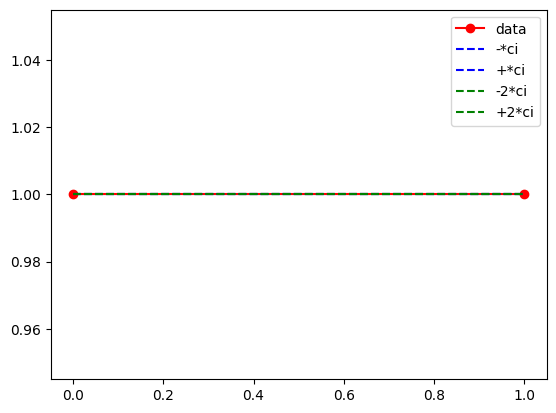

In [22]:
for sim_no in range(len(FAILURE)):
    # isolations way1:
    failure_isolations = [i[sim_no] for i in isolations]
    path = SMALL_WORLD_PATH['ci-node-isolation'] + '/Failure1-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_isolations, path=path)

    # isolations way2
    path = SMALL_WORLD_PATH['ci-node-isolation'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_isolations, path=path)

    # isolations way3
    path = SMALL_WORLD_PATH['ci-node-isolation'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_isolations, path=path)

    # disconnections way1
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = SMALL_WORLD_PATH['ci-node-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_disconnections, path=path)

    # disconnections way2
    path = SMALL_WORLD_PATH['ci-node-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_disconnections, path=path)

    # disconnections way3
    path = SMALL_WORLD_PATH['ci-node-disconnection'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_disconnections, path=path)

### Applying Edge Failure

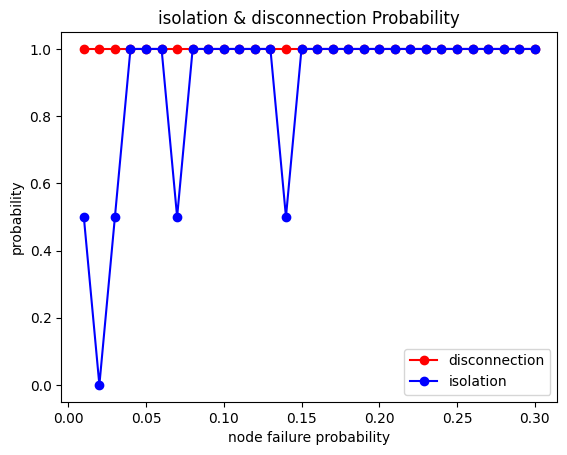

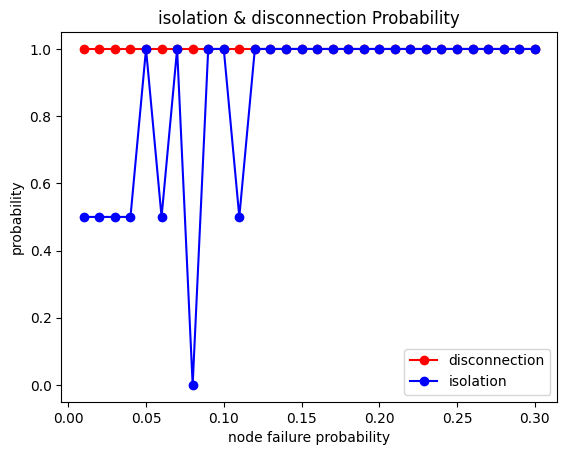

In [23]:
graphs = [info['graph'] for info in small_worlds]

isolations = []
disconnections = []
for i in range(SIMULATION_NUMBER):
    path = SMALL_WORLD_PATH['sim-edge'] + '/SimulationNumber' + str(i)
    isolation, disconnection = apply_failure(graphs, is_node_failure=False, path=path)
    isolations.append(isolation)
    disconnections.append(disconnection)

###### Comparing Different Simulation for Edge Failure

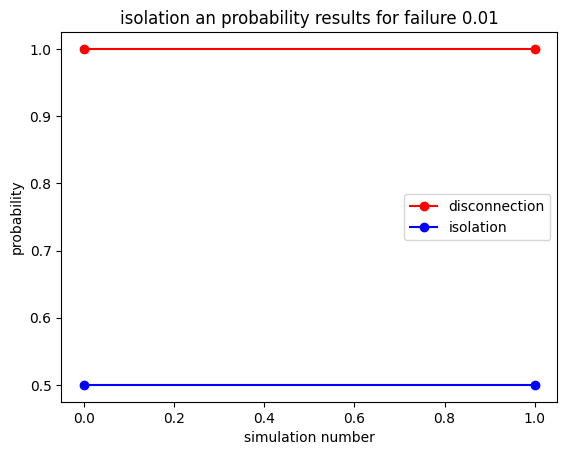

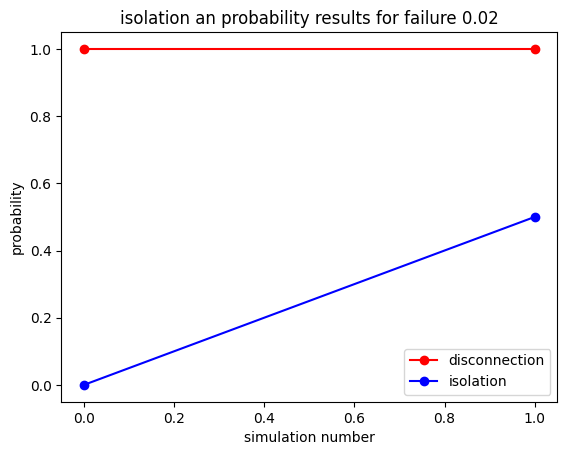

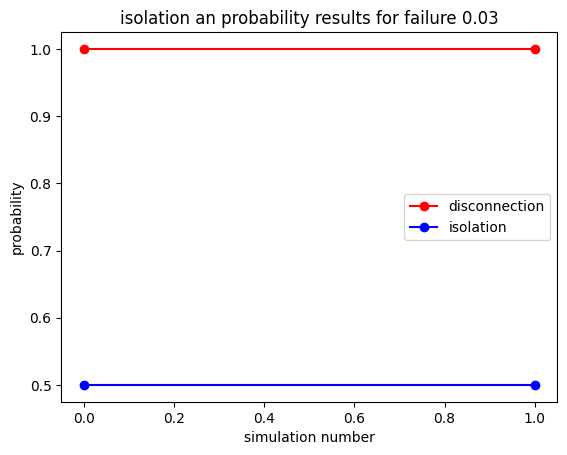

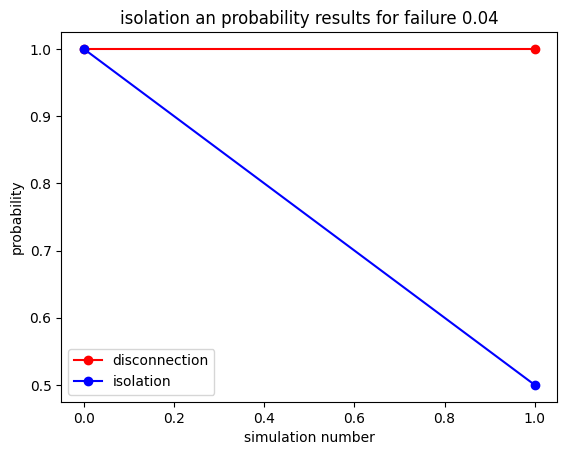

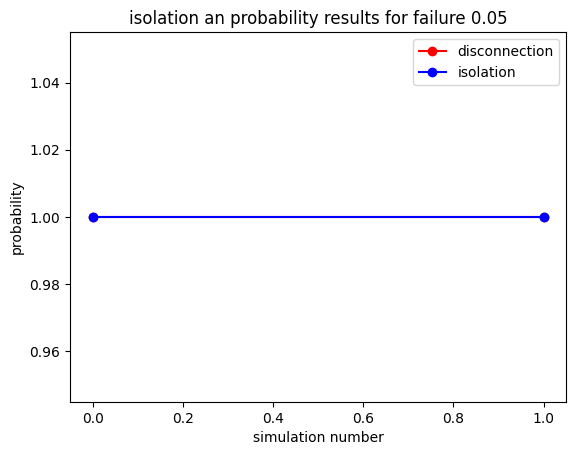

...

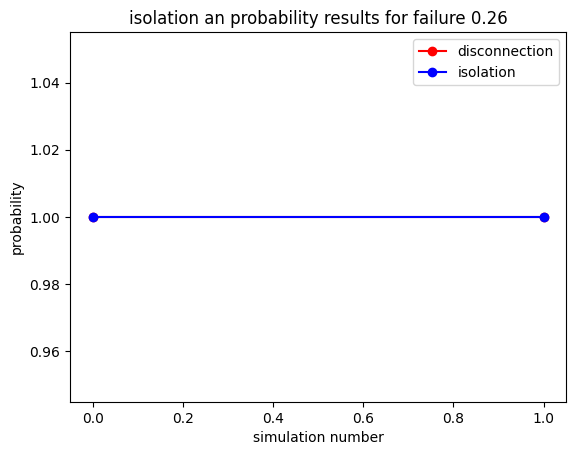

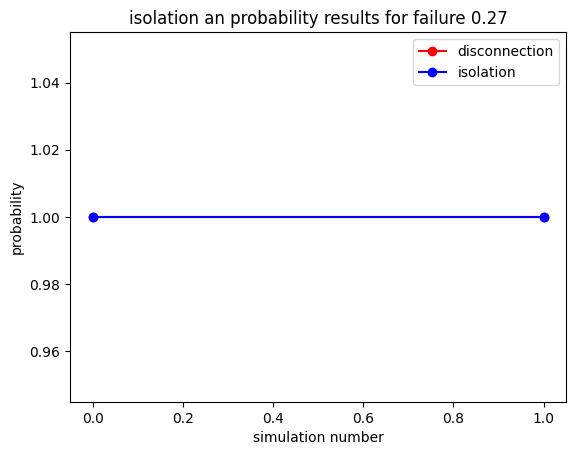

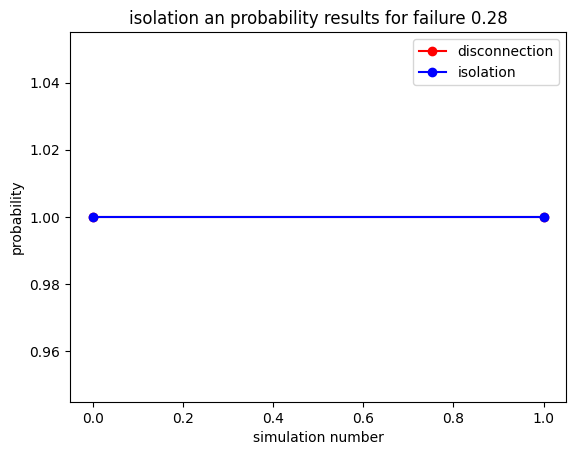

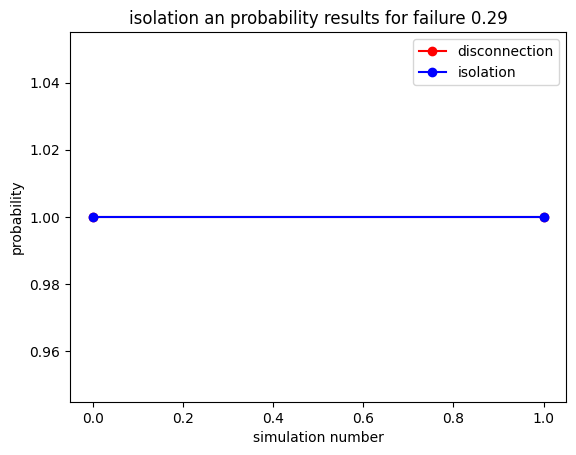

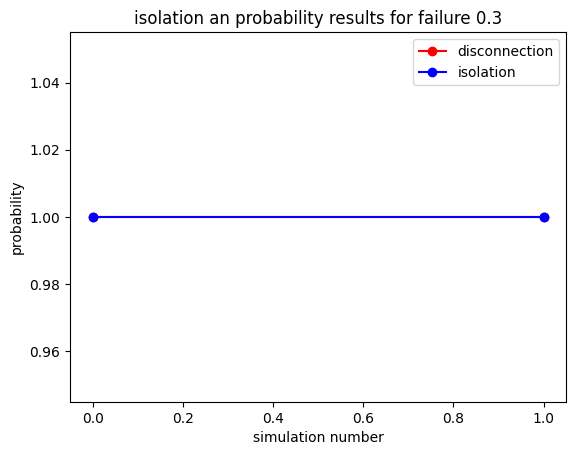

In [24]:
for sim_no in range(len(FAILURE)):
    failure_isolations = [i[sim_no] for i in isolations]
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = SMALL_WORLD_PATH['sim-edge-compare'] + '/Failure' + str(int(100 * FAILURE[sim_no]))
    simulation_diff_plot(failure_isolations, failure_disconnections, FAILURE[sim_no], path=path)

###### Edge C.I

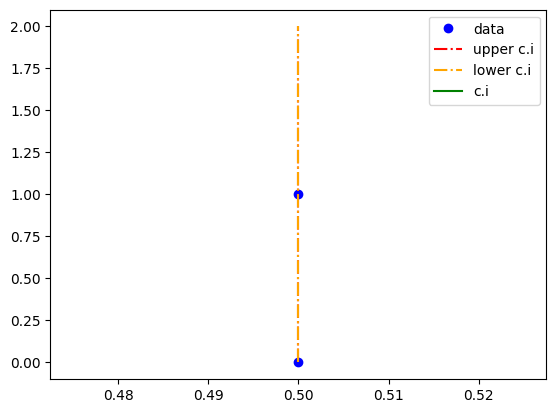

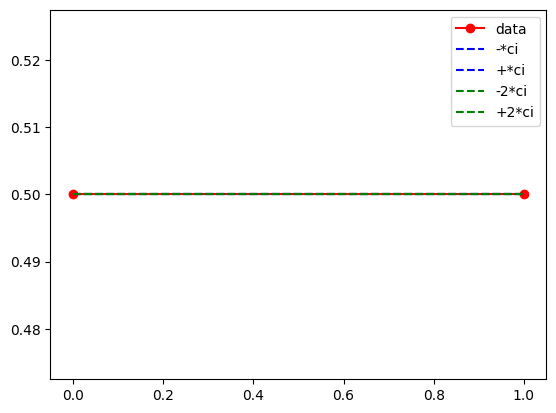

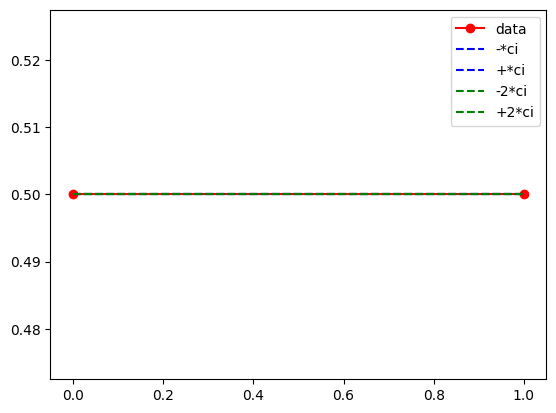

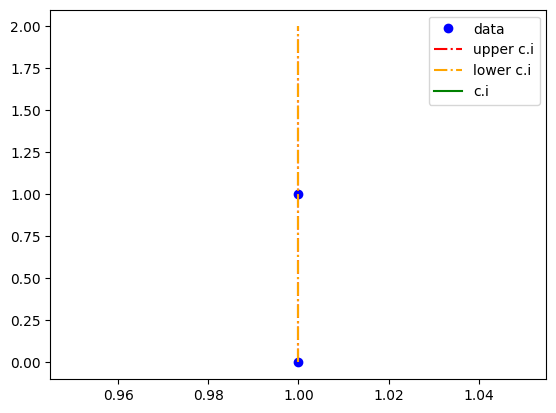

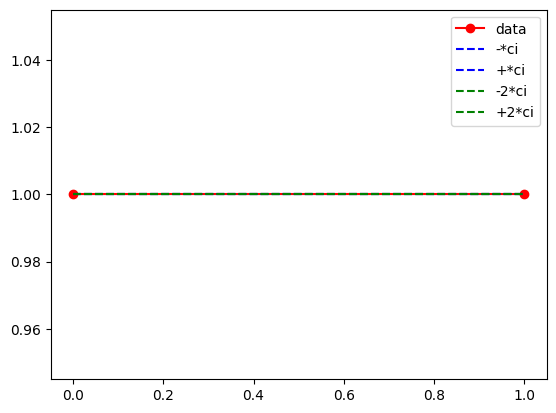

...

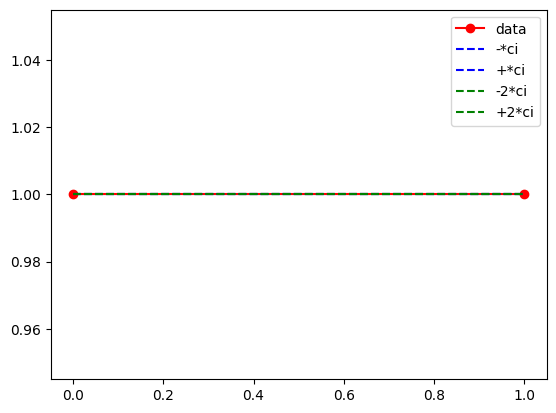

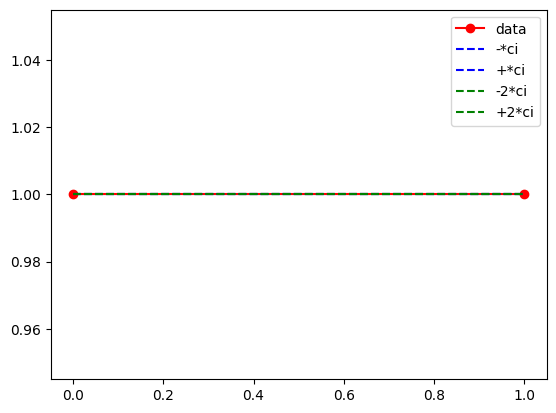

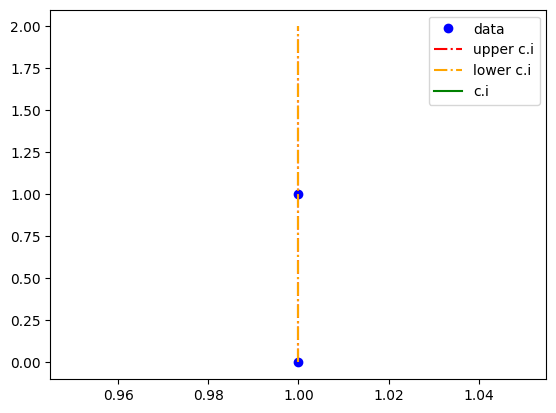

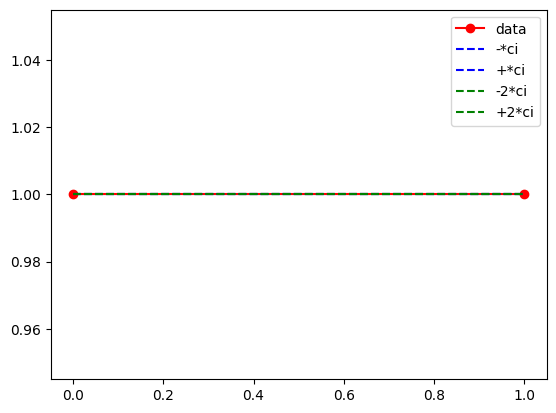

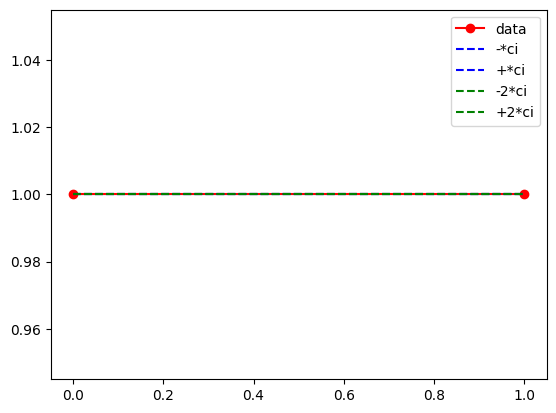

In [25]:
for sim_no in range(len(FAILURE)):
    # isolations way1:
    failure_isolations = [i[sim_no] for i in isolations]
    path = SMALL_WORLD_PATH['ci-edge-isolation'] + '/Failure1-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_isolations, path=path)

    # isolations way2
    path = SMALL_WORLD_PATH['ci-edge-isolation'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_isolations, path=path)

    # isolations way3
    path = SMALL_WORLD_PATH['ci-edge-isolation'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_isolations, path=path)

    # disconnections way1
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = SMALL_WORLD_PATH['ci-edge-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_disconnections, path=path)

    # disconnections way2
    path = SMALL_WORLD_PATH['ci-edge-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_disconnections, path=path)

    # disconnections way3
    path = SMALL_WORLD_PATH['ci-edge-disconnection'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_disconnections, path=path)

# Scale Free

### Making Graph

In [26]:
scale_frees = []
for i in range(GRAPH_NUMBER):
    nodes_number = random.randint(MIN_NODE_NOMBER, MAX_NODE_NUMBER)
    graph = nx.barabasi_albert_graph(nodes_number, random.randint(3, 10))
    graph.remove_edges_from(nx.selfloop_edges(graph))
    graph_dic = {
        'nodes_number': nodes_number,
        'graph': graph
    }
    scale_frees.append(graph_dic)

### Saving Graph

In [27]:
# save_graph_base(scale_frees, SCALE_FREE_PATH)

### Applying Node Failure

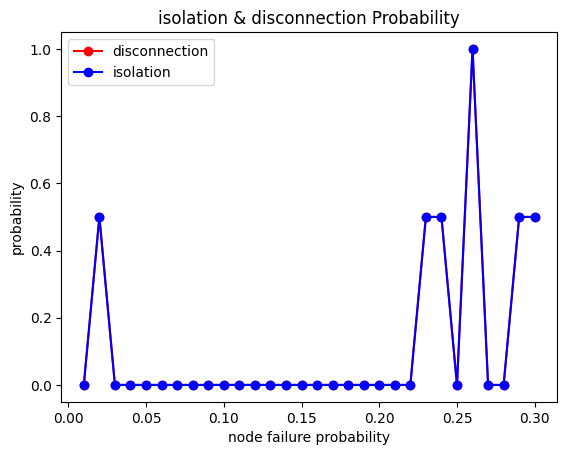

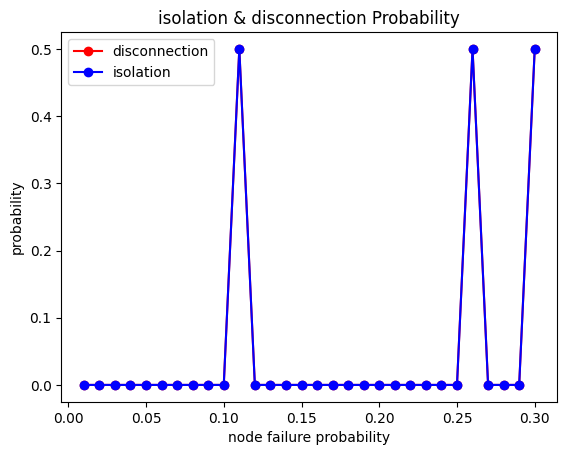

In [28]:
graphs = [info['graph'] for info in scale_frees]

isolations = []
disconnections = []
for i in range(SIMULATION_NUMBER):
    path = SCALE_FREE_PATH['sim-node'] + '/SimulationNumber' + str(i)
    isolation, disconnection = apply_failure(graphs, is_node_failure=True, path=path)
    isolations.append(isolation)
    disconnections.append(disconnection)

###### Comparing Different Node Failure

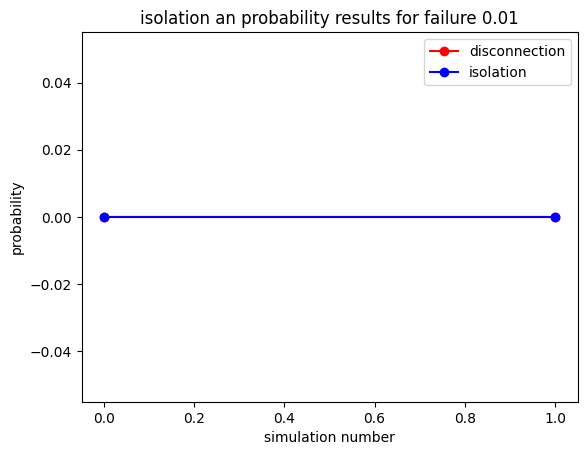

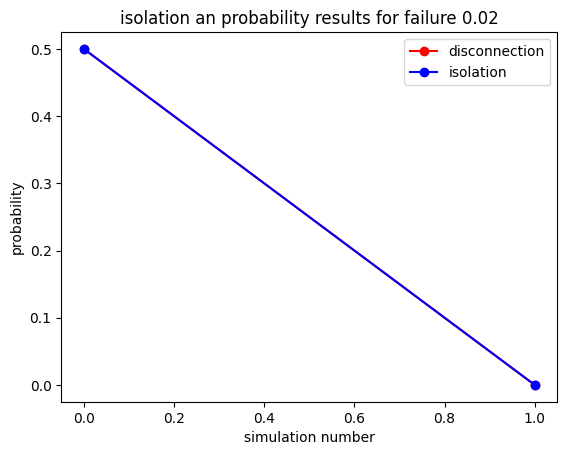

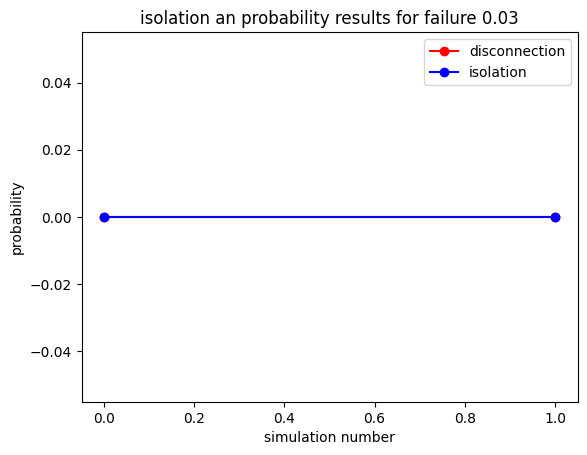

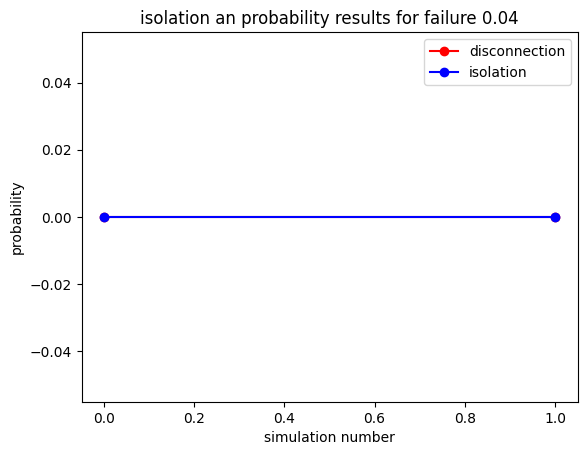

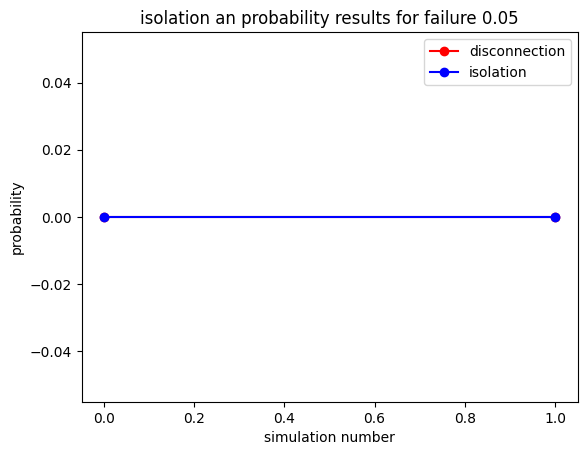

...

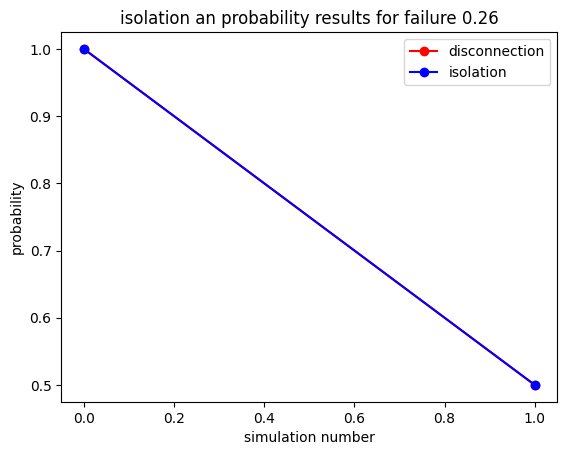

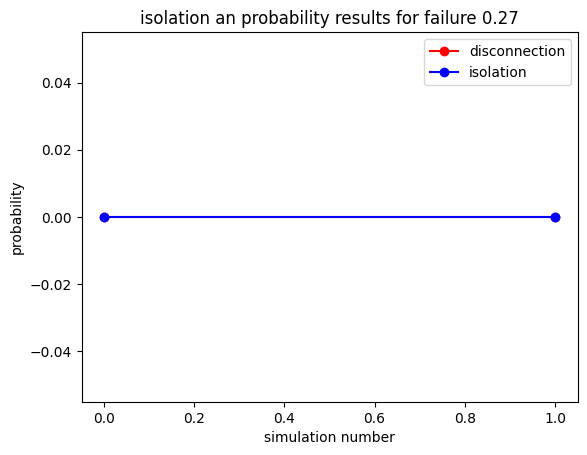

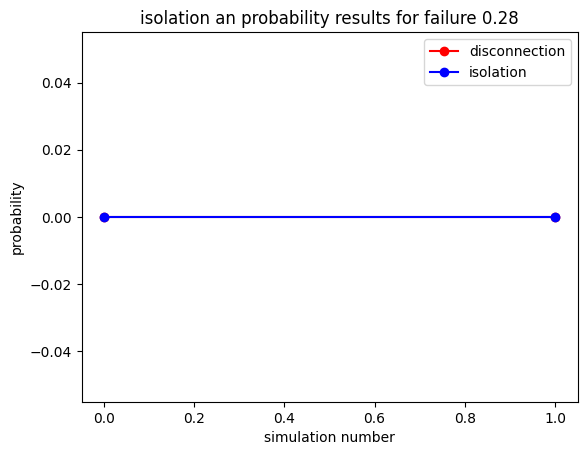

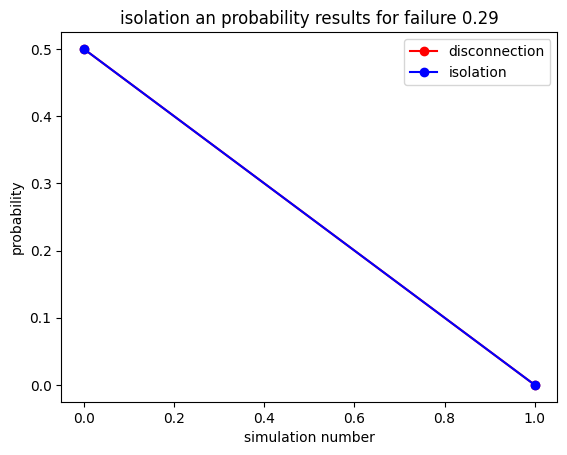

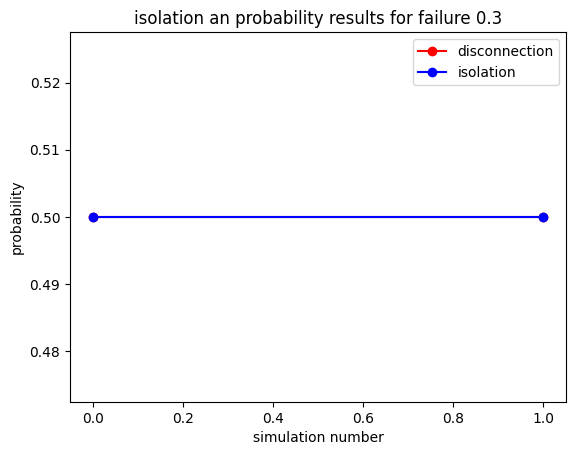

In [29]:
for sim_no in range(len(FAILURE)):
    failure_isolations = [i[sim_no] for i in isolations]
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = SCALE_FREE_PATH['sim-node-compare'] + '/Failure' + str(int(100 * FAILURE[sim_no]))
    simulation_diff_plot(failure_isolations, failure_disconnections, FAILURE[sim_no], path=path)

###### Node CI

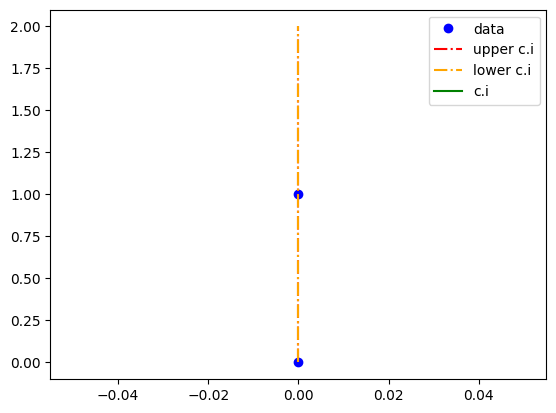

<ipython-input-7-0ffeaae0d318>:8: RuntimeWarning: invalid value encountered in scalar divide
  ci = (1.0-alpha) * np.std(y) / np.mean(y)


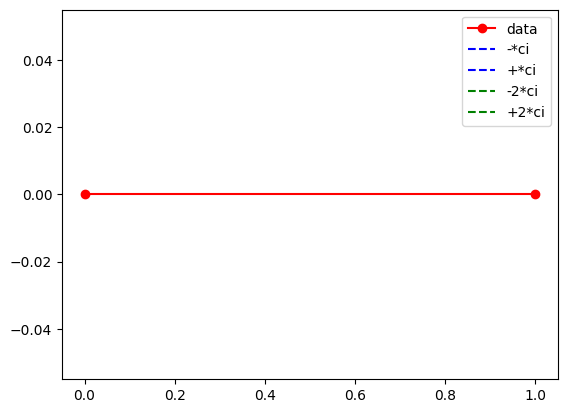

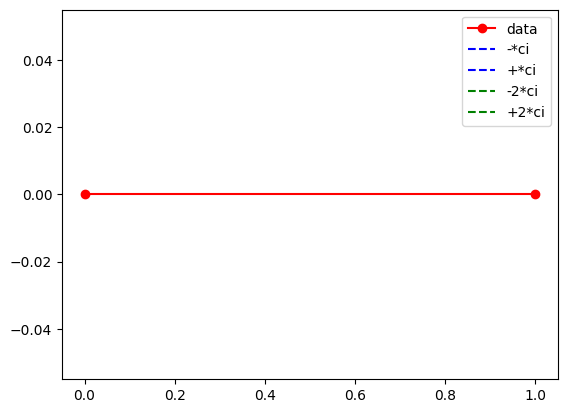

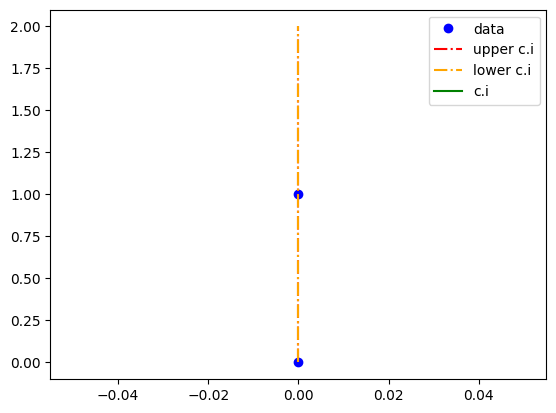

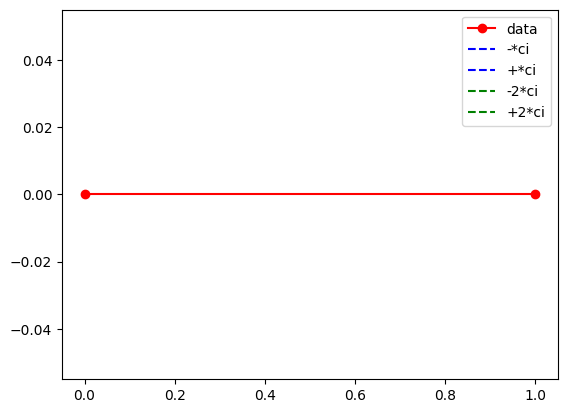

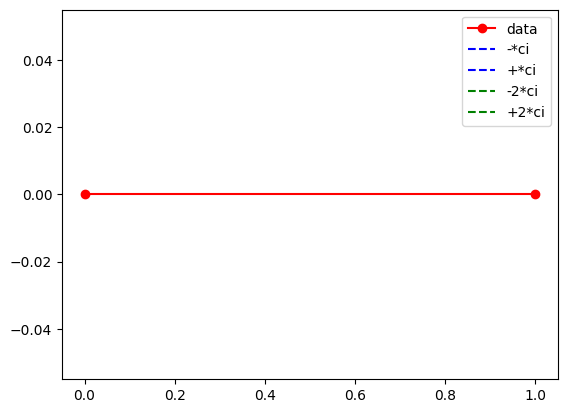

...

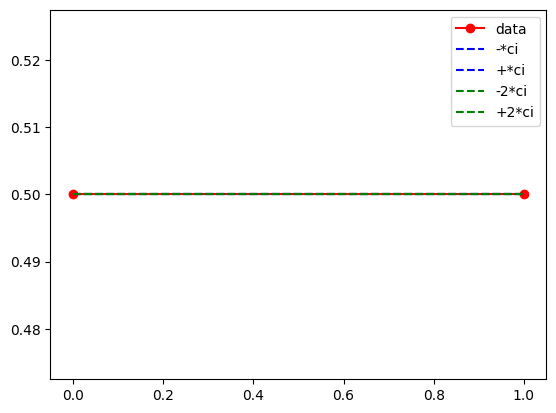

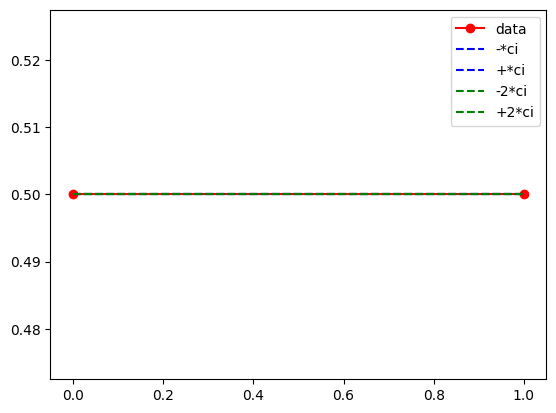

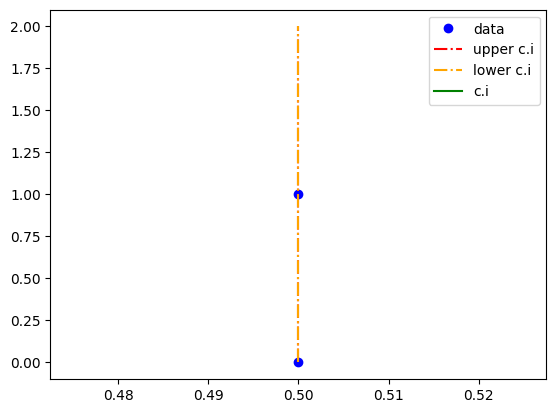

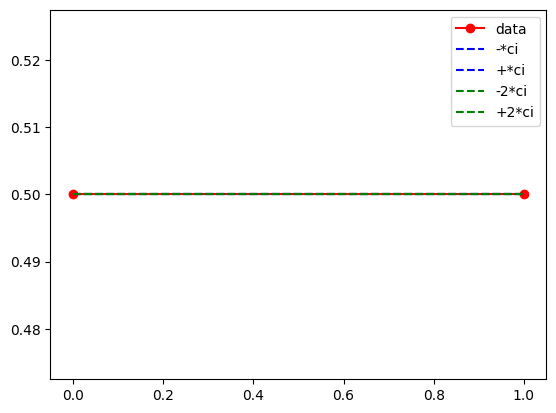

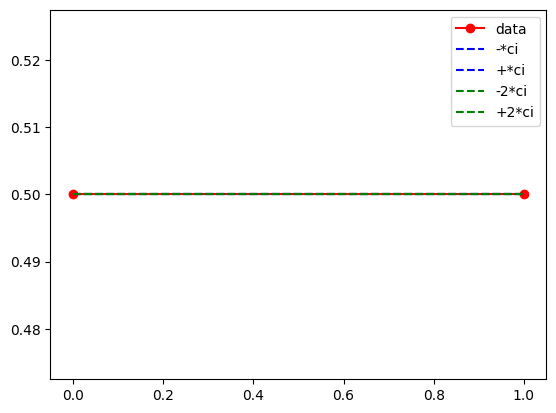

In [30]:
for sim_no in range(len(FAILURE)):
    # isolations way1:
    failure_isolations = [i[sim_no] for i in isolations]
    path = SCALE_FREE_PATH['ci-node-isolation'] + '/Failure1-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_isolations, path=path)

    # isolations way2
    path = SCALE_FREE_PATH['ci-node-isolation'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_isolations, path=path)

    # isolations way3
    path = SCALE_FREE_PATH['ci-node-isolation'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_isolations, path=path)

    # disconnections way1
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = SCALE_FREE_PATH['ci-node-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_disconnections, path=path)

    # disconnections way2
    path = SCALE_FREE_PATH['ci-node-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_disconnections, path=path)

    # disconnections way3
    path = SCALE_FREE_PATH['ci-node-disconnection'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_disconnections, path=path)

### Applying Edge Failure

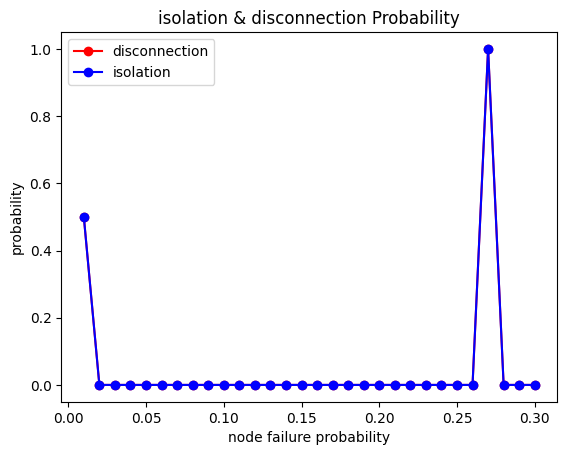

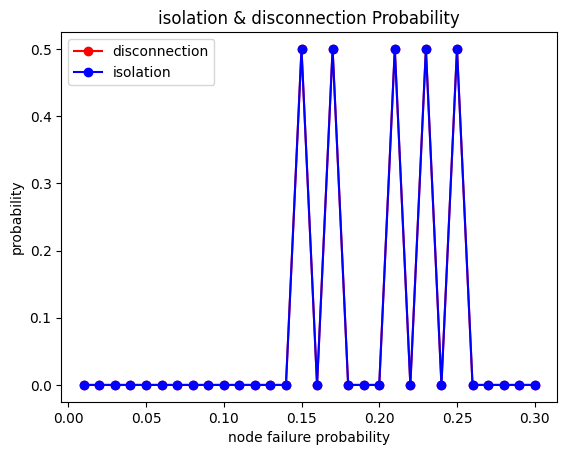

In [31]:
graphs = [info['graph'] for info in scale_frees]

isolations = []
disconnections = []
for i in range(SIMULATION_NUMBER):
    path = SCALE_FREE_PATH['sim-edge'] + '/SimulationNumber' + str(i)
    isolation, disconnection = apply_failure(graphs, is_node_failure=True, path=path)
    isolations.append(isolation)
    disconnections.append(disconnection)

###### Comparing Different Edge Failures

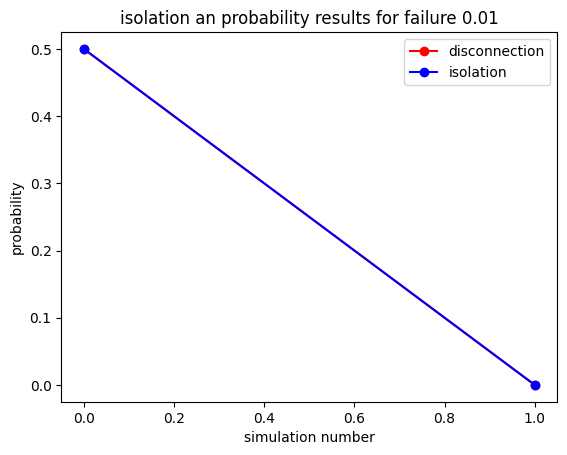

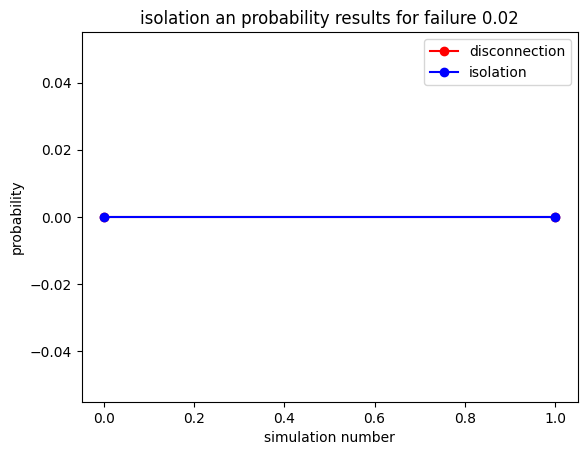

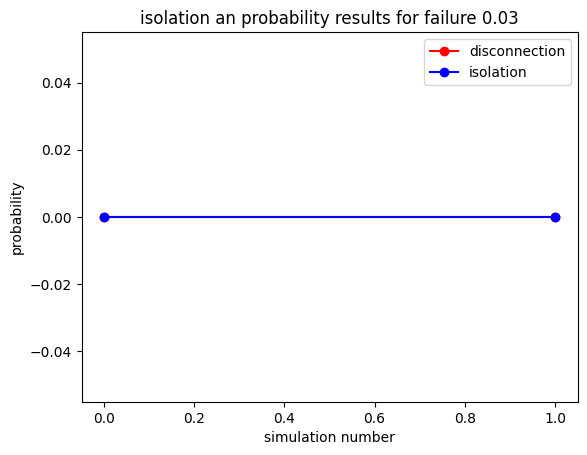

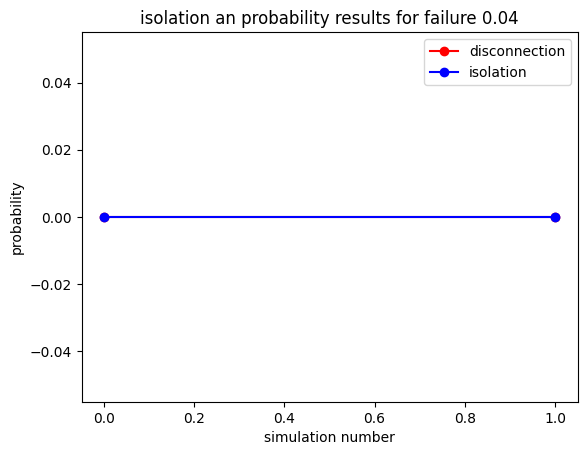

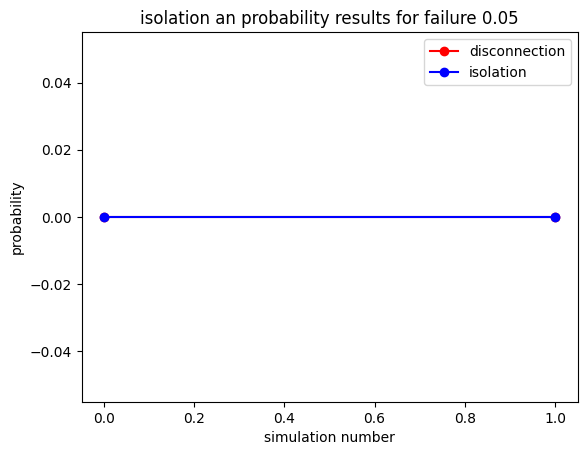

...

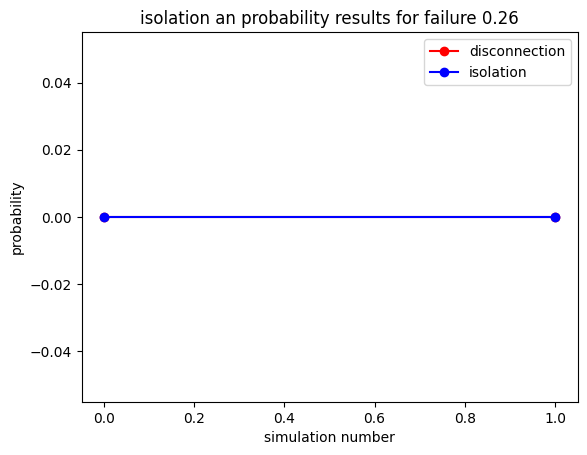

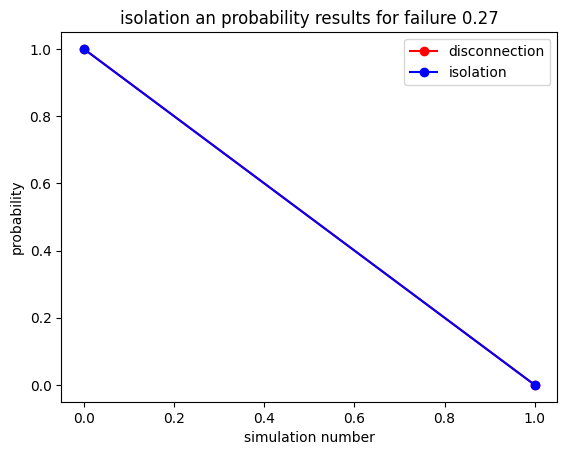

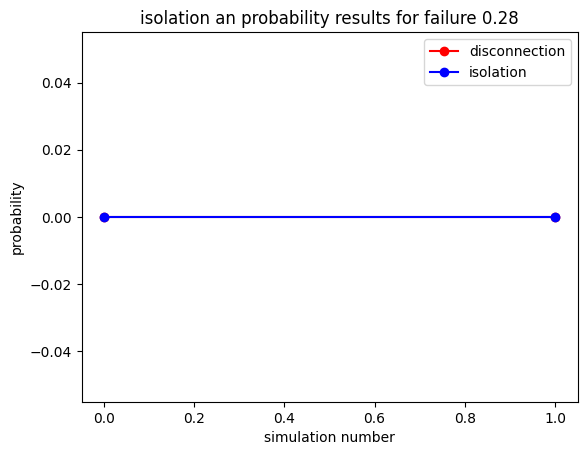

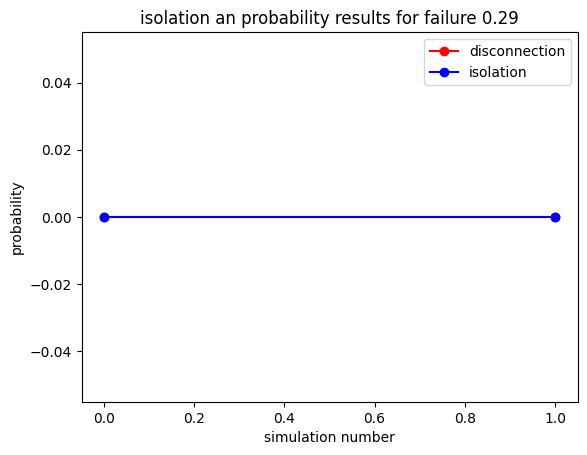

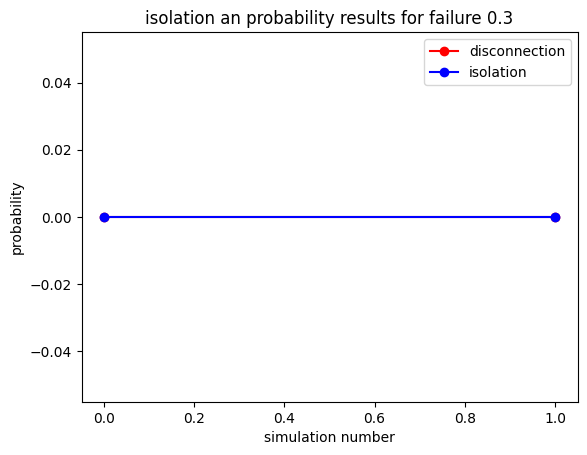

In [32]:
for sim_no in range(len(FAILURE)):
    failure_isolations = [i[sim_no] for i in isolations]
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = SCALE_FREE_PATH['sim-edge-compare'] + '/Failure' + str(int(100 * FAILURE[sim_no]))
    simulation_diff_plot(failure_isolations, failure_disconnections, FAILURE[sim_no], path=path)

###### Edge C.I

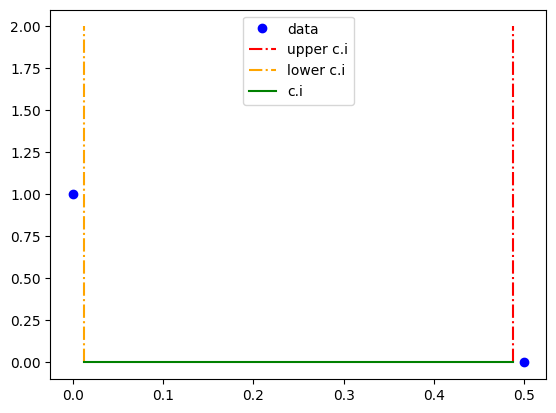

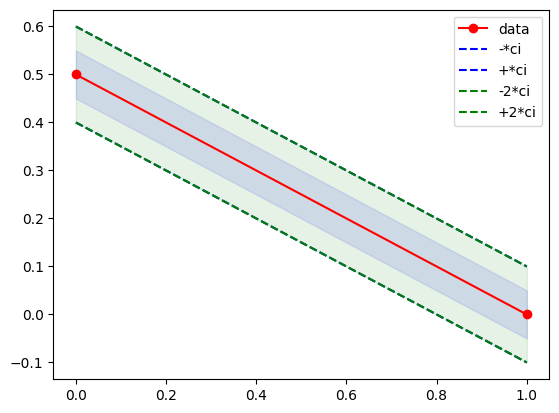

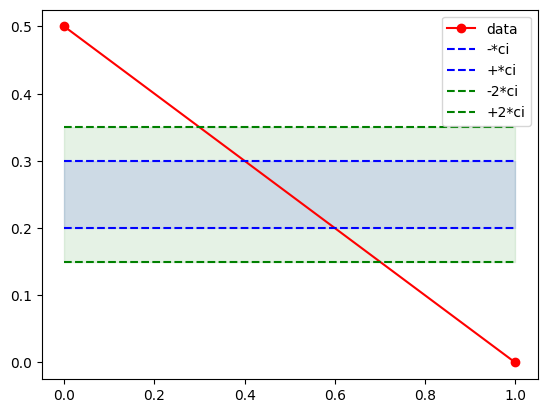

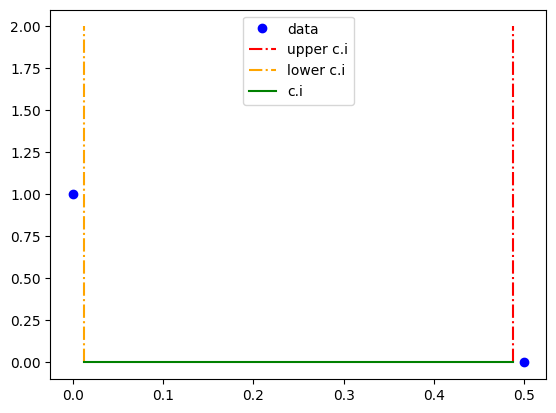

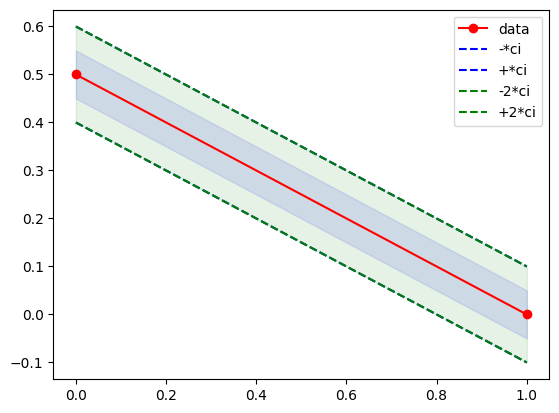

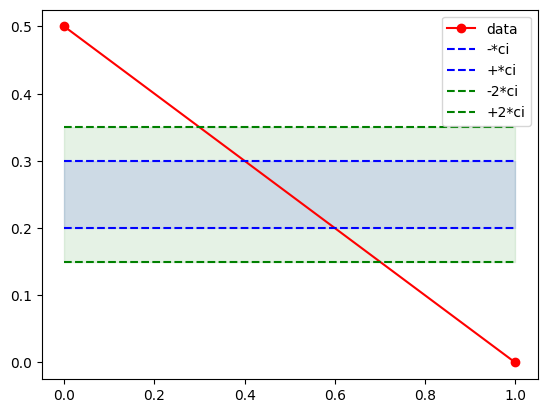

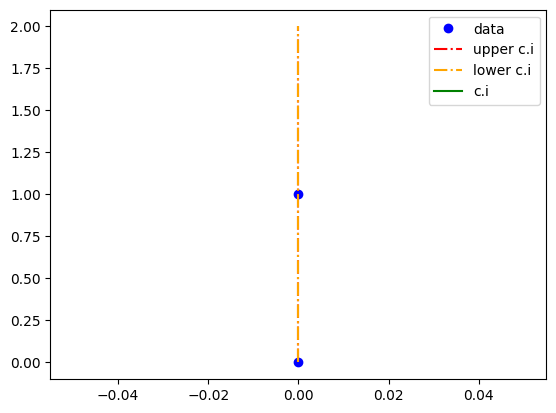

<ipython-input-7-0ffeaae0d318>:8: RuntimeWarning: invalid value encountered in scalar divide
  ci = (1.0-alpha) * np.std(y) / np.mean(y)


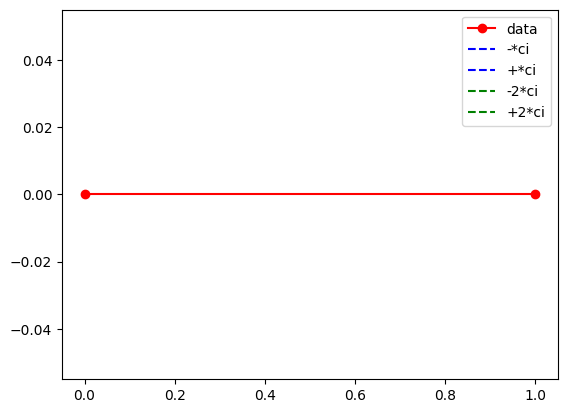

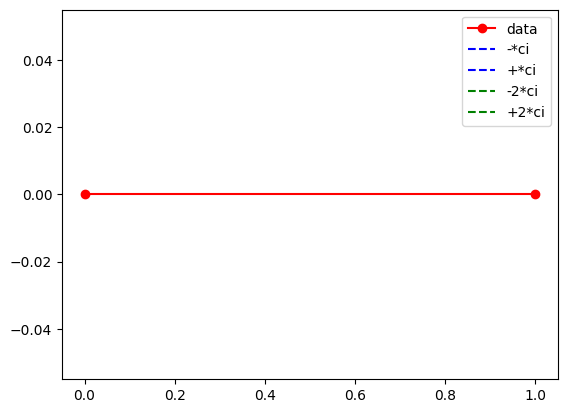

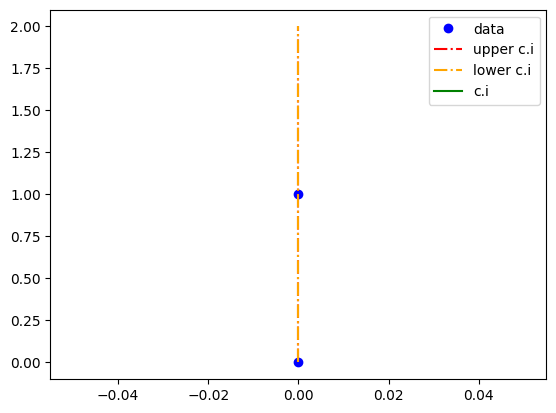

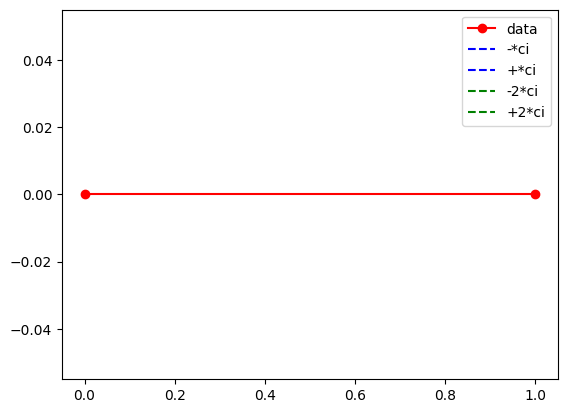

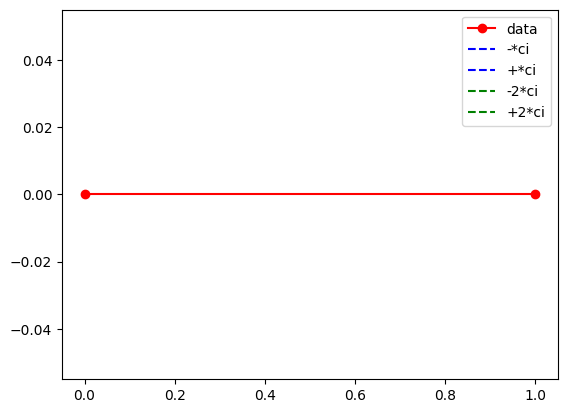

...

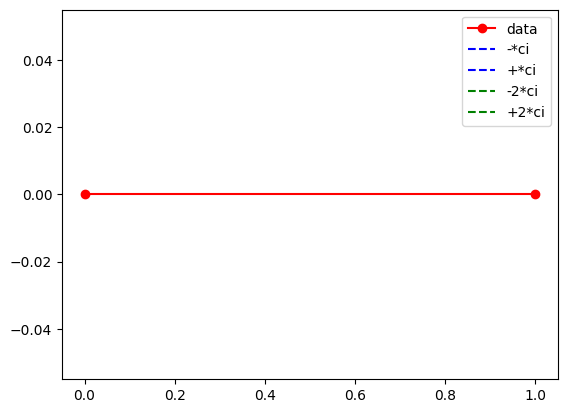

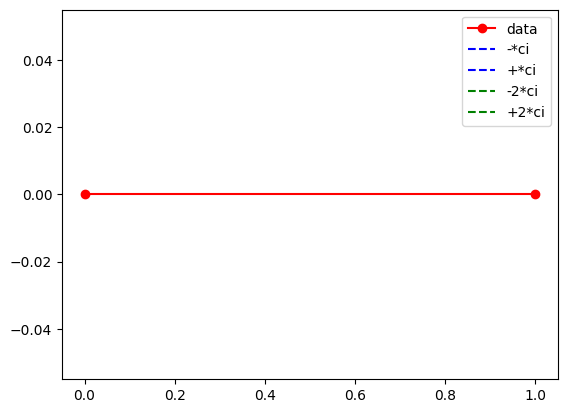

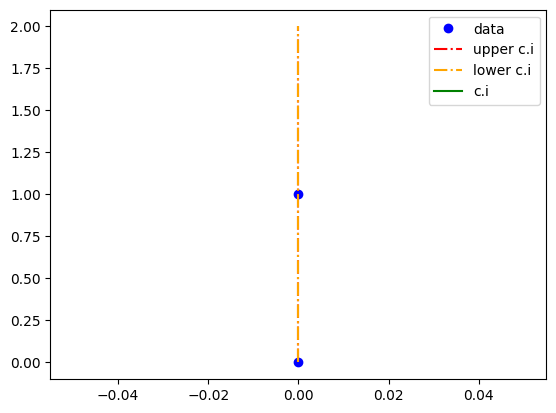

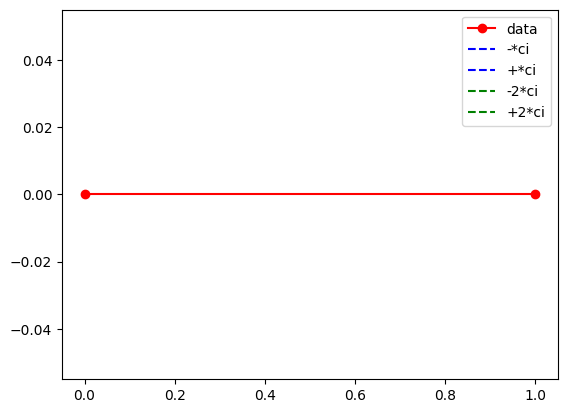

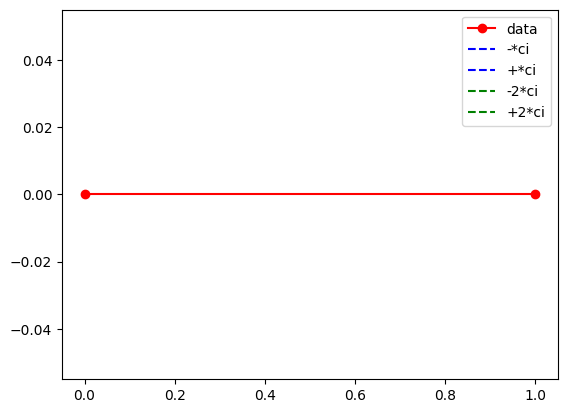

In [33]:
for sim_no in range(len(FAILURE)):
    # isolations way1:
    failure_isolations = [i[sim_no] for i in isolations]
    path = SCALE_FREE_PATH['ci-edge-isolation'] + '/Failure1-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_isolations, path=path)

    # isolations way2
    path = SCALE_FREE_PATH['ci-edge-isolation'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_isolations, path=path)

    # isolations way3
    path = SCALE_FREE_PATH['ci-edge-isolation'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_isolations, path=path)

    # disconnections way1
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = SCALE_FREE_PATH['ci-edge-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_disconnections, path=path)

    # disconnections way2
    path = SCALE_FREE_PATH['ci-edge-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_disconnections, path=path)

    # disconnections way3
    path = SCALE_FREE_PATH['ci-edge-disconnection'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_disconnections, path=path)

# Random

### Making Graphs

In [34]:
randoms = []
for i in range(GRAPH_NUMBER):
    nodes_number = random.randint(MIN_NODE_NOMBER, MAX_NODE_NUMBER)
    edge_probability = random.uniform(0.15, 0.45)
    graph = nx.erdos_renyi_graph(nodes_number, edge_probability)
    graph_dic = {
        'nodes_number': nodes_number,
        'edge_probability': edge_probability,
        'graph': graph
    }
    randoms.append(graph_dic)

### Saving Graphs

In [35]:
# save_graph_base(randoms, RANDOM_PATH)

### Applying Node Failure

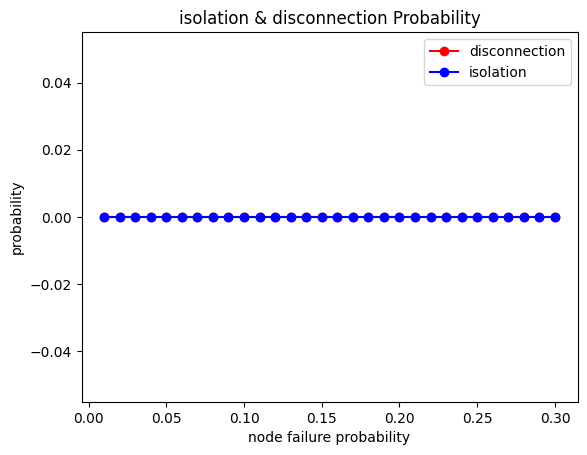

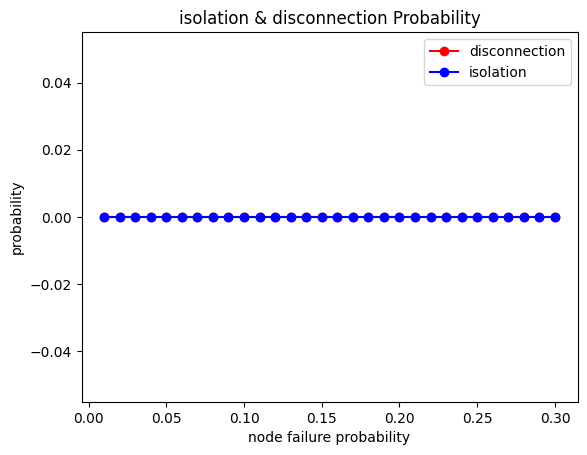

In [36]:
graphs = [info['graph'] for info in randoms]

isolations = []
disconnections = []
for i in range(SIMULATION_NUMBER):
    path = RANDOM_PATH['sim-node'] + '/SimulationNumber' + str(i)
    isolation, disconnection = apply_failure(graphs, is_node_failure=True, path=path)
    isolations.append(isolation)
    disconnections.append(disconnection)

###### Comparing Different Node Failures

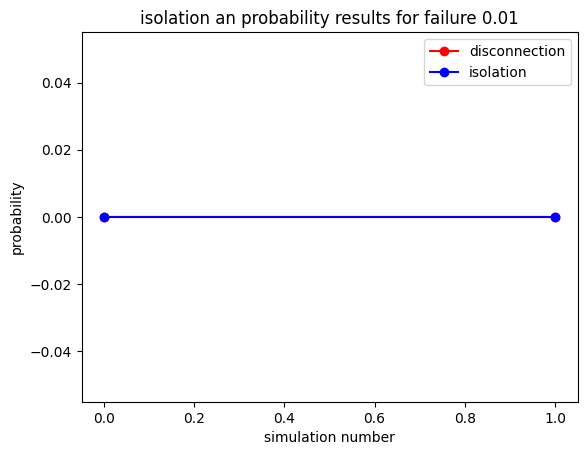

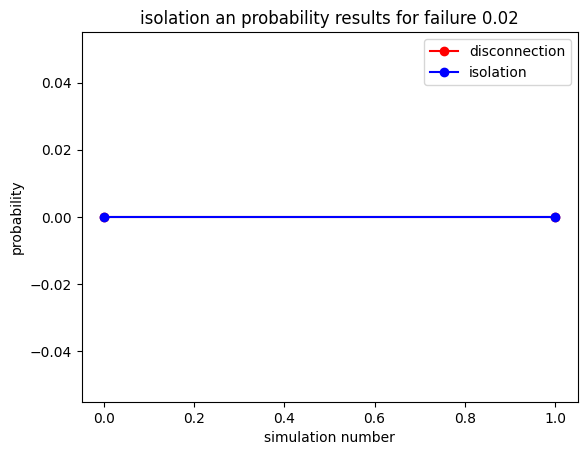

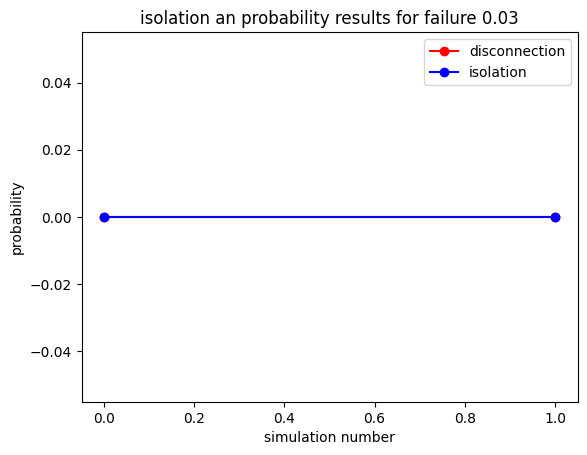

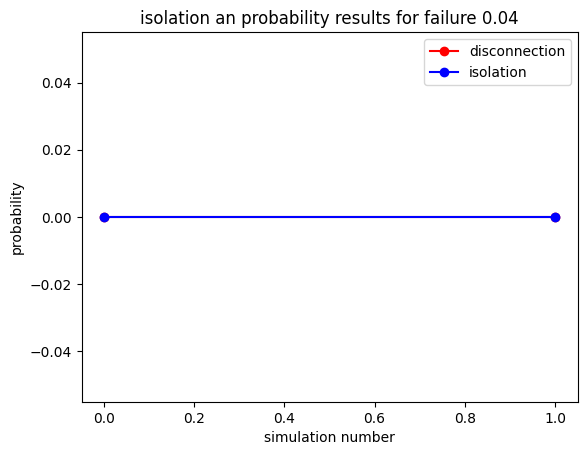

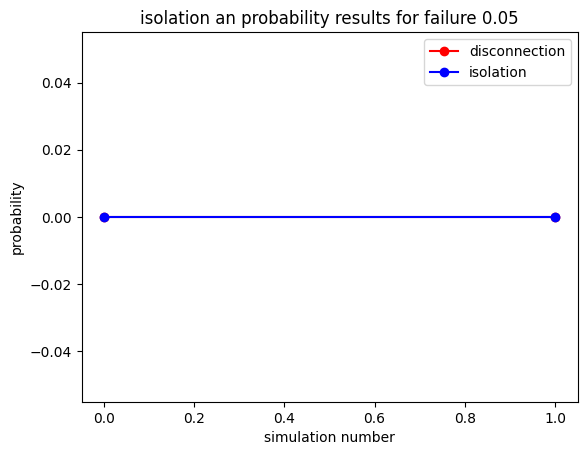

...

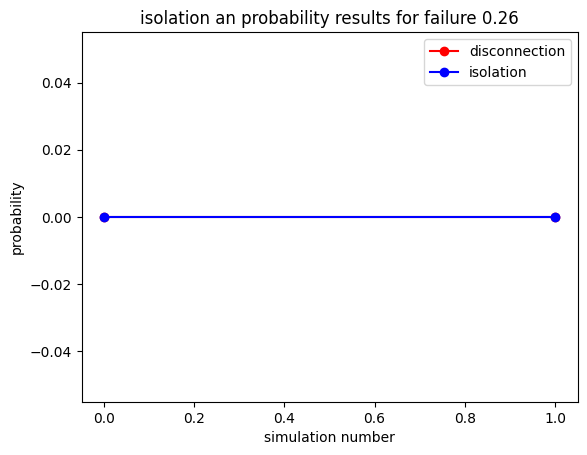

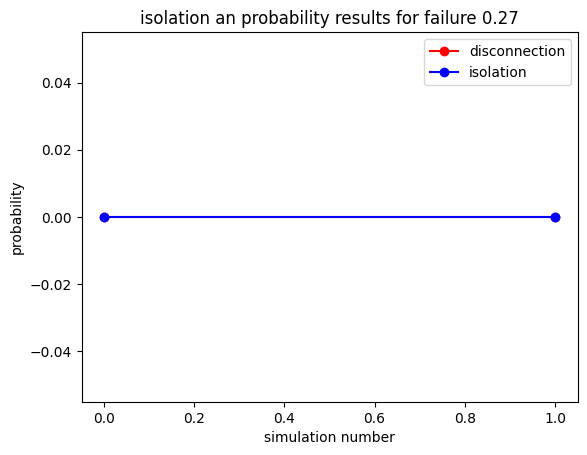

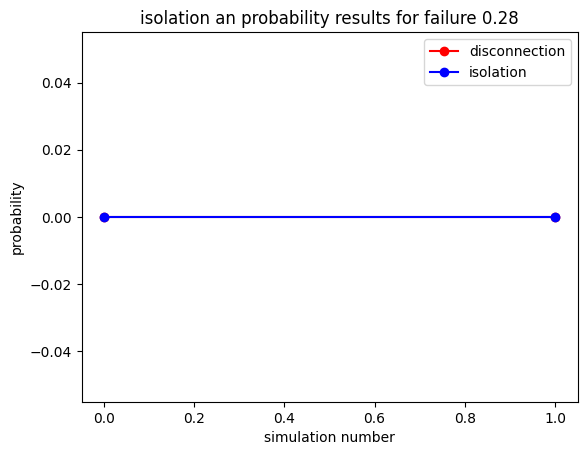

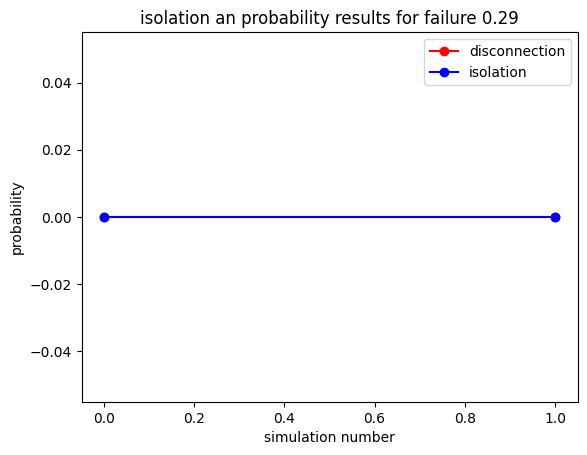

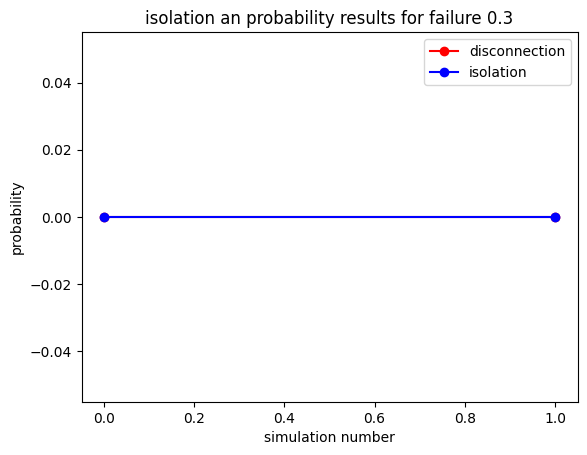

In [37]:
for sim_no in range(len(FAILURE)):
    failure_isolations = [i[sim_no] for i in isolations]
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = RANDOM_PATH['sim-node-compare'] + '/Failure' + str(int(100 * FAILURE[sim_no]))
    simulation_diff_plot(failure_isolations, failure_disconnections, FAILURE[sim_no], path=path)

###### Node C.I

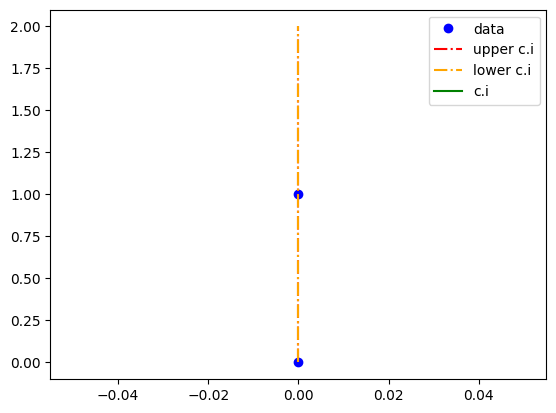

<ipython-input-7-0ffeaae0d318>:8: RuntimeWarning: invalid value encountered in scalar divide
  ci = (1.0-alpha) * np.std(y) / np.mean(y)


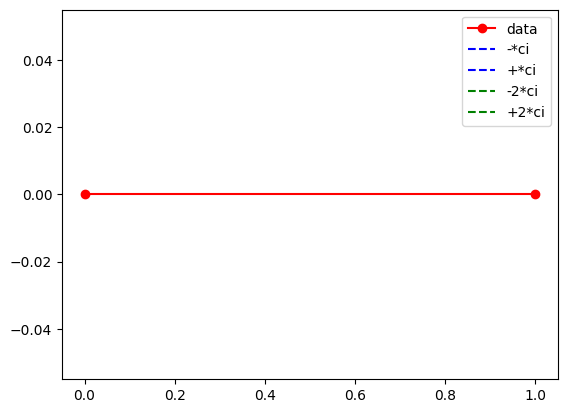

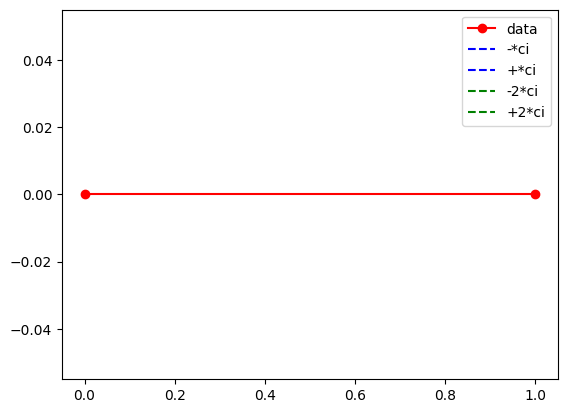

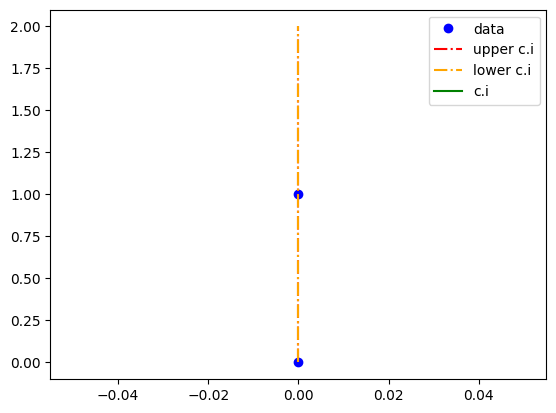

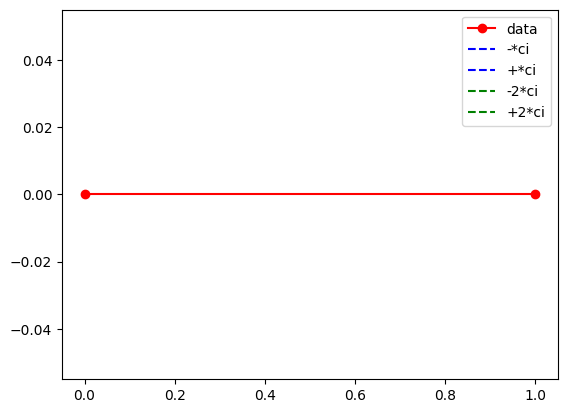

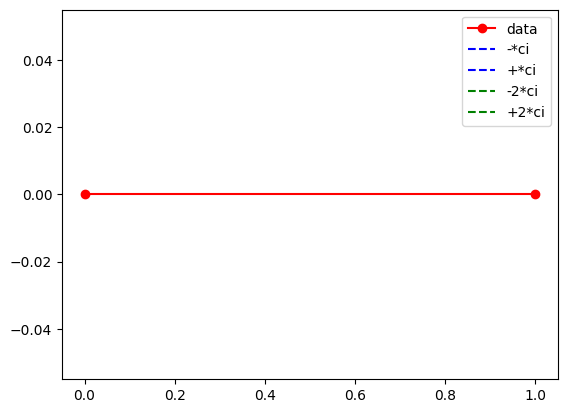

...

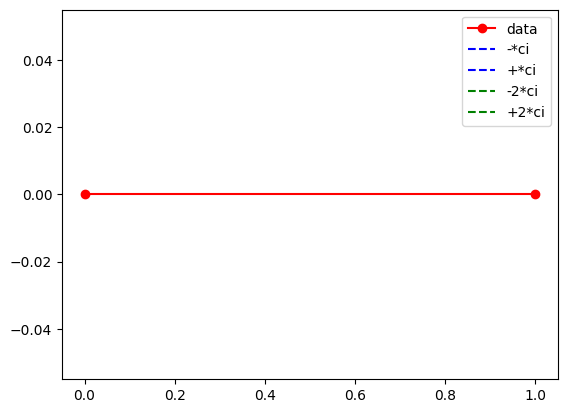

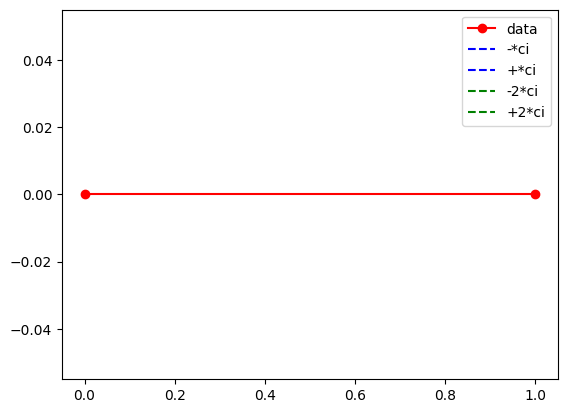

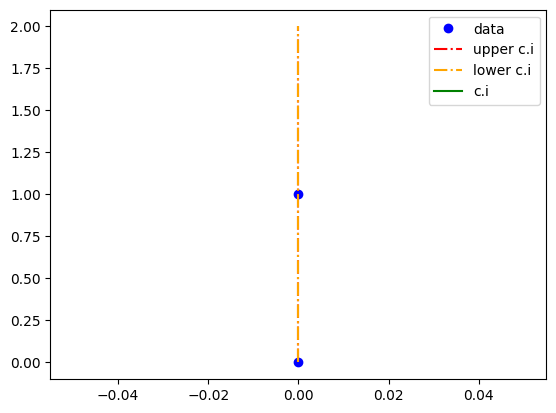

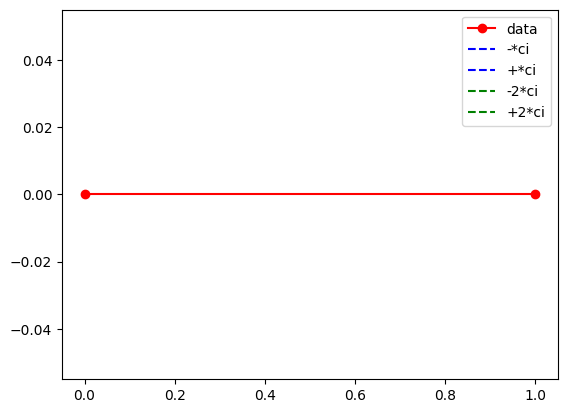

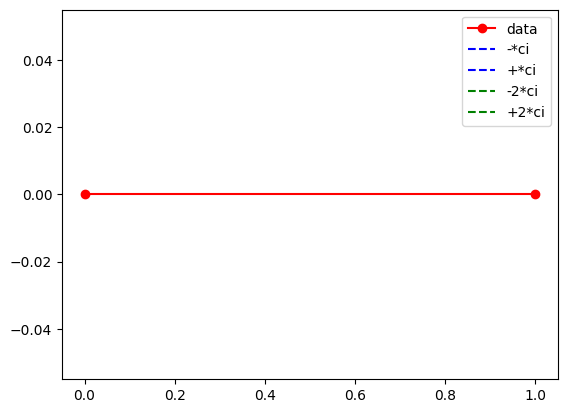

In [38]:
for sim_no in range(len(FAILURE)):
    # isolations way1:
    failure_isolations = [i[sim_no] for i in isolations]
    path = RANDOM_PATH['ci-node-isolation'] + '/Failure1-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_isolations, path=path)

    # isolations way2
    path = RANDOM_PATH['ci-node-isolation'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_isolations, path=path)

    # isolations way3
    path = RANDOM_PATH['ci-node-isolation'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_isolations, path=path)

    # disconnections way1
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = RANDOM_PATH['ci-node-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_disconnections, path=path)

    # disconnections way2
    path = RANDOM_PATH['ci-node-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_disconnections, path=path)

    # disconnections way3
    path = RANDOM_PATH['ci-node-disconnection'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_disconnections, path=path)

### Applying Edge Failure

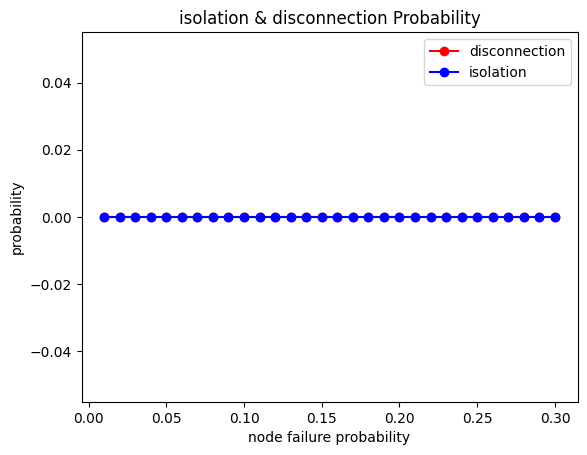

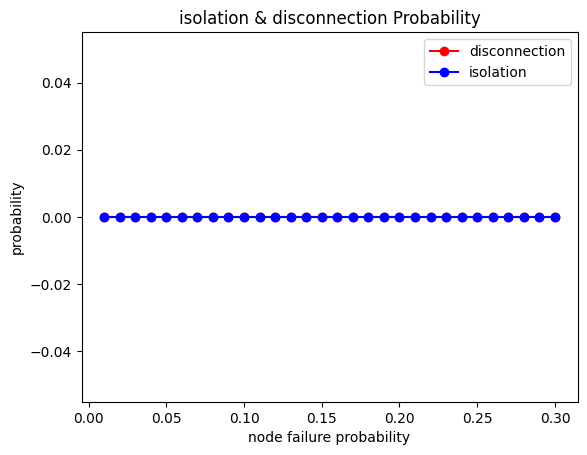

In [39]:
graphs = [info['graph'] for info in randoms]

isolations = []
disconnections = []
for i in range(SIMULATION_NUMBER):
    path = RANDOM_PATH['sim-edge'] + '/SimulationNumber' + str(i)
    isolation, disconnection = apply_failure(graphs, is_node_failure=True, path=path)
    isolations.append(isolation)
    disconnections.append(disconnection)

###### Comparing Different Edge Failure

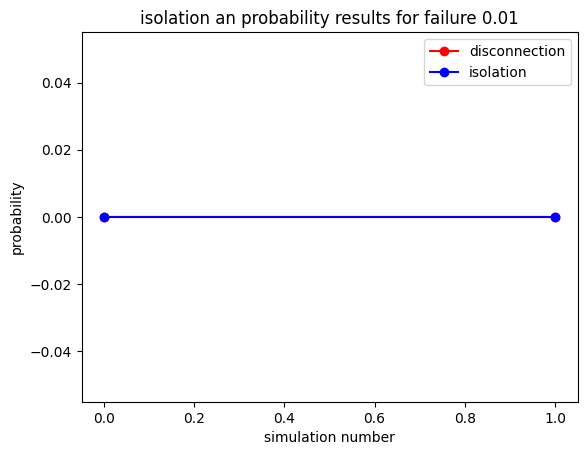

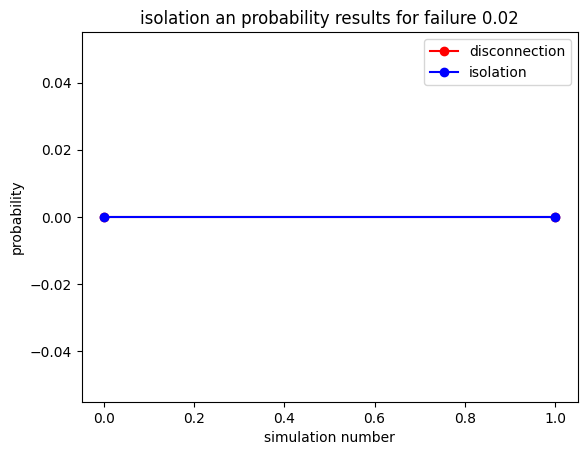

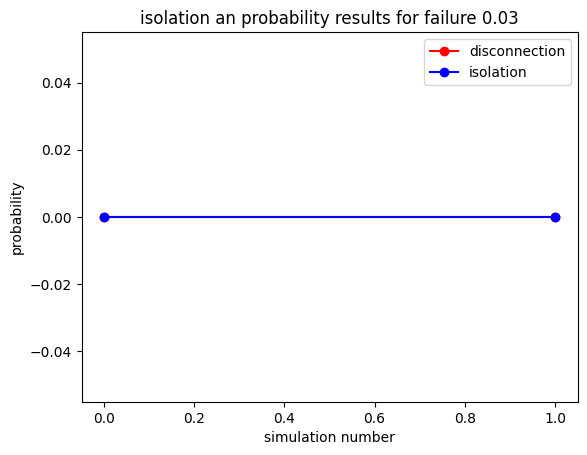

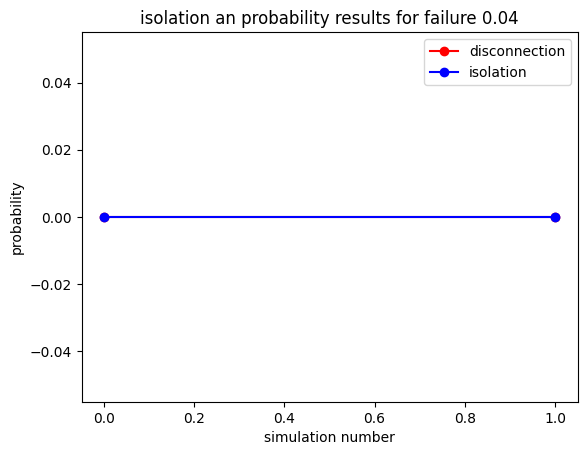

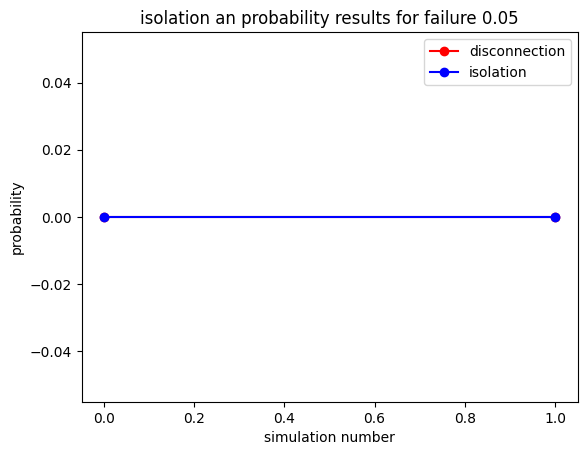

...

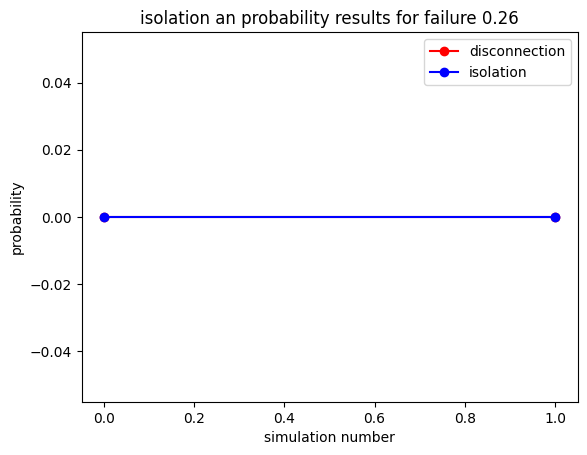

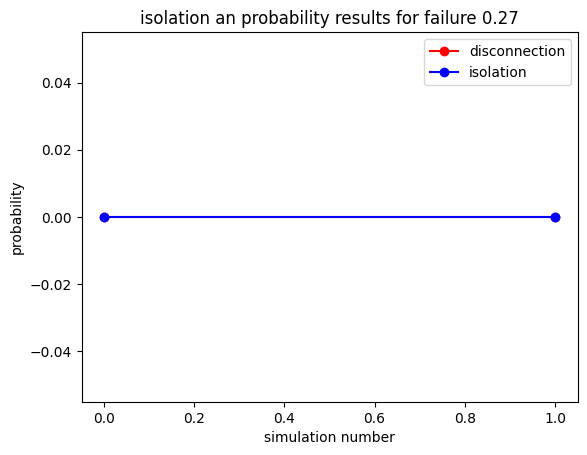

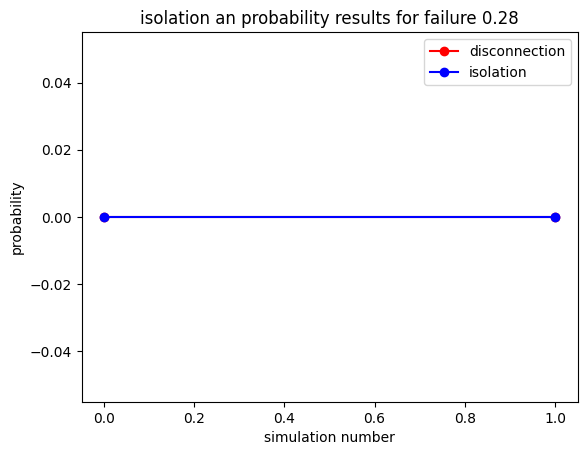

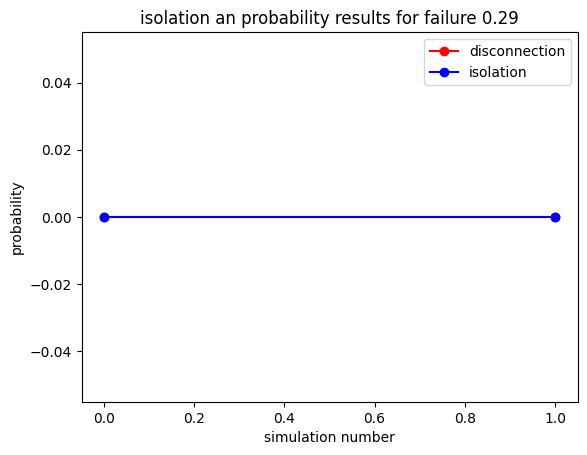

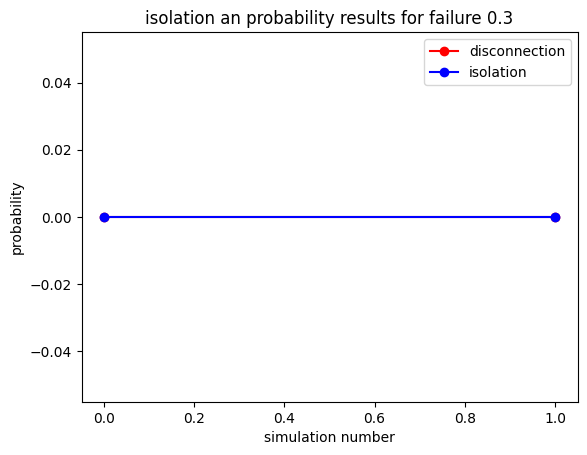

In [40]:
for sim_no in range(len(FAILURE)):
    failure_isolations = [i[sim_no] for i in isolations]
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = RANDOM_PATH['sim-edge-compare'] + '/Failure' + str(int(100 * FAILURE[sim_no]))
    simulation_diff_plot(failure_isolations, failure_disconnections, FAILURE[sim_no], path=path)

###### Edge C.I

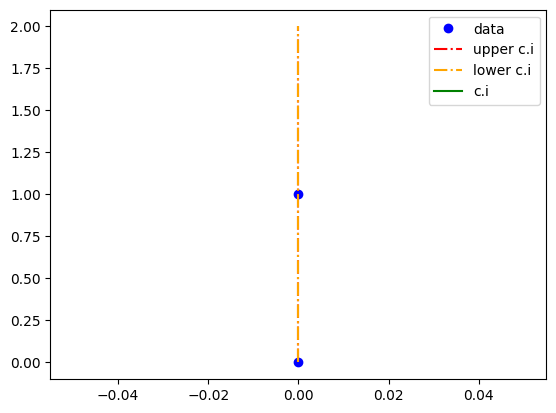

<ipython-input-7-0ffeaae0d318>:8: RuntimeWarning: invalid value encountered in scalar divide
  ci = (1.0-alpha) * np.std(y) / np.mean(y)


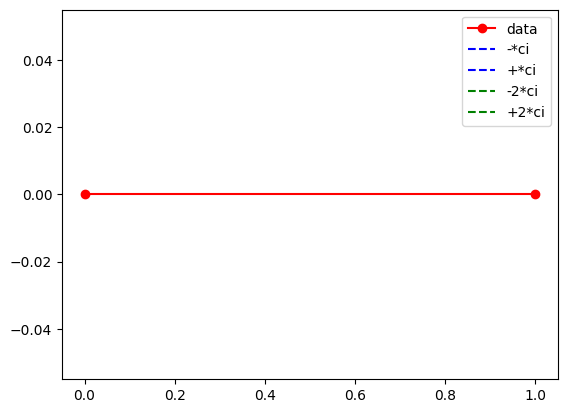

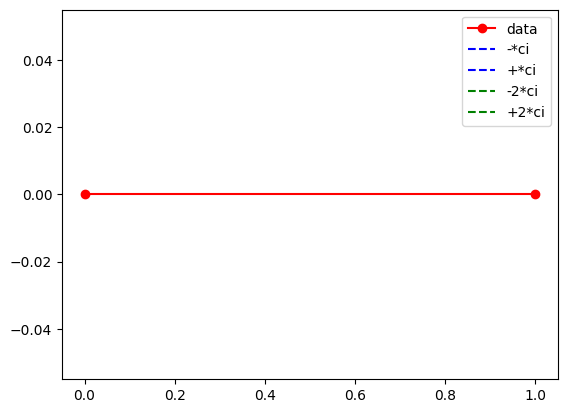

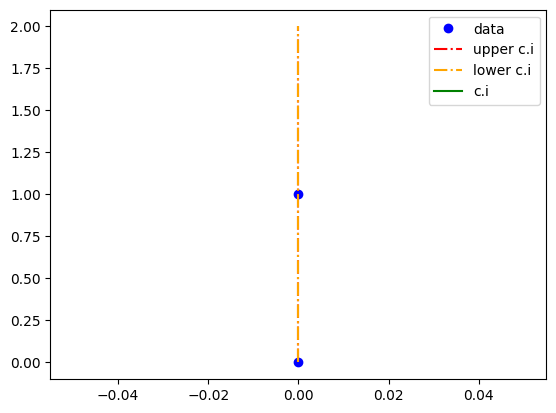

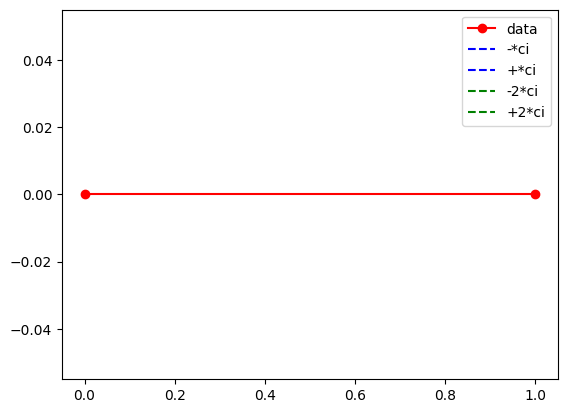

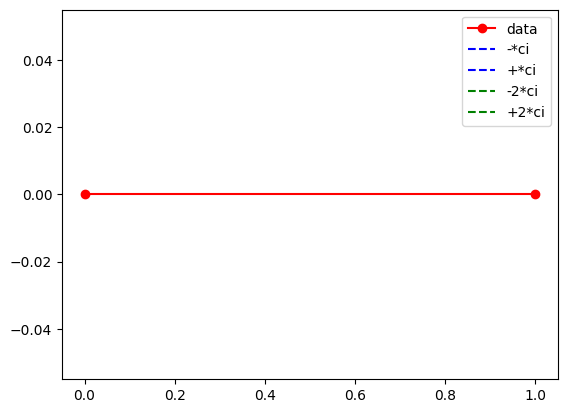

...

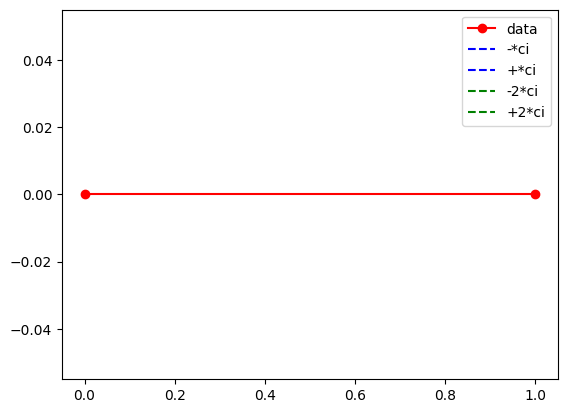

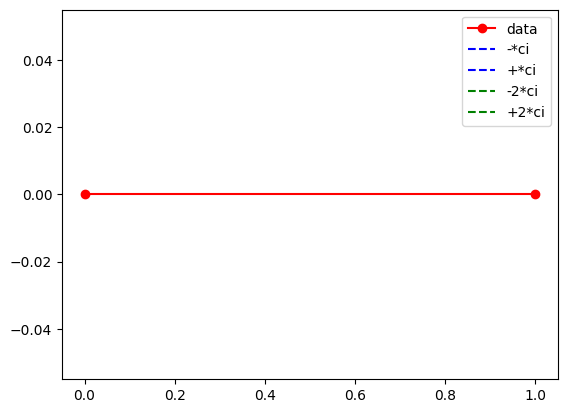

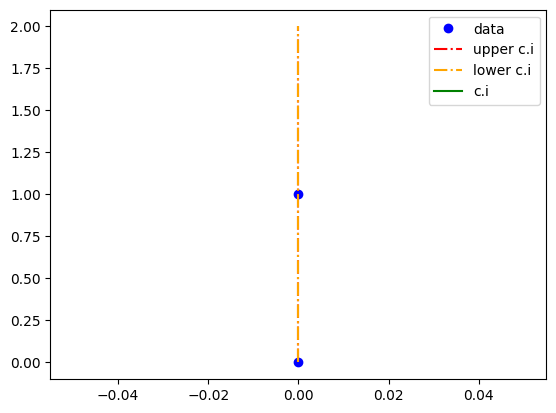

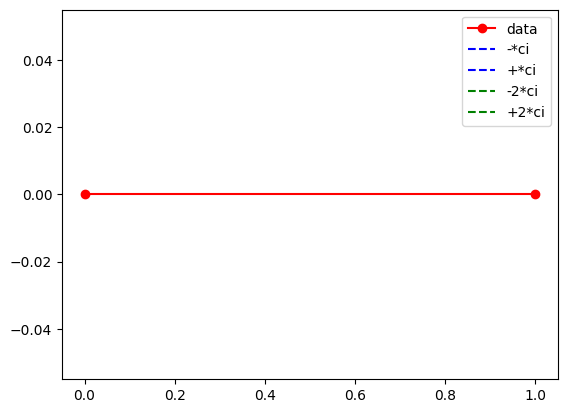

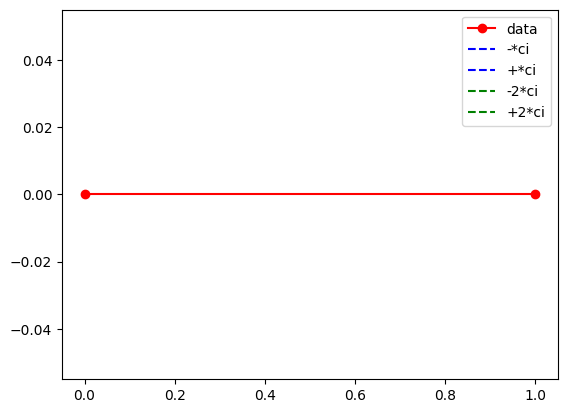

In [41]:
for sim_no in range(len(FAILURE)):
    # isolations way1:
    failure_isolations = [i[sim_no] for i in isolations]
    path = RANDOM_PATH['ci-edge-isolation'] + '/Failure1-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_isolations, path=path)

    # isolations way2
    path = RANDOM_PATH['ci-edge-isolation'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_isolations, path=path)

    # isolations way3
    path = RANDOM_PATH['ci-edge-isolation'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_isolations, path=path)

    # disconnections way1
    failure_disconnections = [i[sim_no] for i in disconnections]
    path = RANDOM_PATH['ci-edge-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot(failure_disconnections, path=path)

    # disconnections way2
    path = RANDOM_PATH['ci-edge-disconnection'] + '/Failure2-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot2(failure_disconnections, path=path)

    # disconnections way3
    path = RANDOM_PATH['ci-edge-disconnection'] + '/Failure3-' + str(int(100 * FAILURE[sim_no]))
    coefficient_interval_plot3(failure_disconnections, path=path)